# PROBLEM

An online store wants to understand how much a customer will spend based on features such as gender,product category 

and other features. They want a model that can predict what a customer will purchase so as to have better 

personalized discounts. 

# Type of ML

1.Supervised Machine  learning because we have the label which is purchase

2.Batch learning.We are training using all available data

3.Regression task.We are predicting a continuos variable purchase

# Performance Measure

The performance measure is Root Mean Squared Error.

# 1.Load dependencies and data

In [1367]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cufflinks as cf
import seaborn as sns
from plotly.offline import init_notebook_mode,iplot,plot,download_plotlyjs
from scipy import stats
import plotly.graph_objs as go
from scipy.stats import iqr
import random
from scipy.stats import ttest_ind
from sklearn.preprocessing import Imputer,LabelEncoder,StandardScaler
from sklearn.feature_selection import SelectKBest
from sklearn.model_selection import train_test_split,cross_val_score
from sklearn import metrics
from sklearn.linear_model import LinearRegression,Ridge
from sklearn.tree import DecisionTreeRegressor
import xgboost as xgb
from sklearn.ensemble import RandomForestRegressor
from sklearn.externals import joblib
import sklearn
import matplotlib

In [1135]:
#configure plotly
cf.go_offline()
init_notebook_mode(connected=True)
%matplotlib inline

In [1370]:
print('Numpy version', np.__version__)
print('Scikit version ' , sklearn.__version__)
print('Matplotlib version ' , matplotlib.__version__)
print('Seaborn version ' , sns.__version__)
print('Pandas version ' , pd.__version__)

Numpy version 1.16.2
Scikit version  0.20.1
Matplotlib version  3.0.3
Seaborn version  0.8.1
Pandas version  0.23.0


## 1.1 Check data

In [1137]:
#load 
bf=pd.read_csv('datasets/BlackFriday.csv')

In [1138]:
bf,test=train_test_split(bf,test_size=0.2,random_state=0)

In [1139]:
id_train=bf.index
id_test=test.index

In [1140]:
#check head
bf.head()

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
22467,1003521,P00178342,M,26-35,0,B,3,0,8,NaN,NaN,7837
42611,1000553,P00285842,M,26-35,2,B,1,0,5,NaN,NaN,8762
461991,1005113,P00271342,M,26-35,0,A,3,1,8,14.0,NaN,7778
144091,1004224,P00058142,F,46-50,1,C,1,1,3,4.0,12.0,13701
97400,1003095,P00125642,F,26-35,3,B,1,1,5,14.0,NaN,7158


In [1141]:
#data types
bf.dtypes

User_ID                         int64
Product_ID                     object
Gender                         object
Age                            object
Occupation                      int64
City_Category                  object
Stay_In_Current_City_Years     object
Marital_Status                  int64
Product_Category_1              int64
Product_Category_2            float64
Product_Category_3            float64
Purchase                        int64
dtype: object

In [1142]:
#information on dataset
bf.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 430061 entries, 22467 to 305711
Data columns (total 12 columns):
User_ID                       430061 non-null int64
Product_ID                    430061 non-null object
Gender                        430061 non-null object
Age                           430061 non-null object
Occupation                    430061 non-null int64
City_Category                 430061 non-null object
Stay_In_Current_City_Years    430061 non-null object
Marital_Status                430061 non-null int64
Product_Category_1            430061 non-null int64
Product_Category_2            296702 non-null float64
Product_Category_3            131533 non-null float64
Purchase                      430061 non-null int64
dtypes: float64(2), int64(5), object(5)
memory usage: 42.7+ MB


In [1143]:
#Shape
bf.shape

(430061, 12)

In [1144]:
#null
bf.isnull().sum().sort_values(ascending=False)

Product_Category_3            298528
Product_Category_2            133359
Purchase                           0
Product_Category_1                 0
Marital_Status                     0
Stay_In_Current_City_Years         0
City_Category                      0
Occupation                         0
Age                                0
Gender                             0
Product_ID                         0
User_ID                            0
dtype: int64

In [1145]:
#describe
bf.describe()

,User_ID,Occupation,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
count,4.300610e+05,430061.000000,430061.000000,430061.00000,296702.000000,131533.000000,430061.000000
mean,1.002990e+06,8.082523,0.408526,5.28974,9.842889,12.666190,9337.547650
std,1.714440e+03,6.519846,0.491562,3.75091,5.090413,4.126827,4983.335909
min,1.000001e+06,0.000000,0.000000,1.00000,2.000000,3.000000,185.000000
25%,1.001492e+06,2.000000,0.000000,1.00000,5.000000,9.000000,5867.000000
50%,1.003029e+06,7.000000,0.000000,5.00000,9.000000,14.000000,8063.000000
75%,1.004414e+06,14.000000,1.000000,8.00000,15.000000,16.000000,12074.000000
max,1.006040e+06,20.000000,1.000000,18.00000,18.000000,18.000000,23961.000000


# 2.EDA

# 2.1 Univariate

In [1146]:
#Product IDs with their respective counts
bf['Product_ID'].value_counts()

P00265242    1497
P00110742    1279
P00025442    1266
P00112142    1236
P00057642    1139
P00046742    1132
P00184942    1126
P00237542    1122
P00058042    1122
P00059442    1120
P00145042    1100
P00117942    1097
P00010742    1085
P00110942    1084
P00255842    1069
P00102642    1011
P00051442    1005
P00117442    1001
P00220442     997
P00110842     993
P00278642     981
P00080342     951
P00028842     951
P00148642     951
P00242742     950
P00031042     942
P00270942     934
P00034742     931
P00251242     916
P00114942     910
             ... 
P00080442       1
P00056642       1
P00038642       1
P00300742       1
P00163942       1
P00353742       1
P00104342       1
P00204442       1
P00075042       1
P00122142       1
P00108742       1
P00299042       1
P00054442       1
P00091742       1
P00132742       1
P00305442       1
P00298842       1
P00066342       1
P00038842       1
P00162742       1
P00104042       1
P00063442       1
P00295642       1
P00242242       1
P00275042 

## 2.1.1 Purchase 

/home/lytica/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_axes.py:6521: MatplotlibDeprecationWarning:


The 'normed' kwarg was deprecated in Matplotlib 2.1 and will be removed in 3.1. Use 'density' instead.

/home/lytica/anaconda3/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.



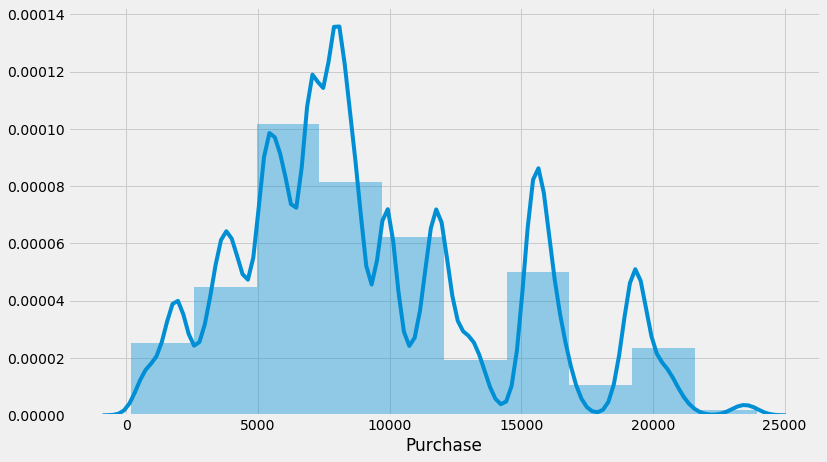

In [1147]:
#Distribution of purchase
plt.style.use('fivethirtyeight')
plt.figure(figsize=(12,7))
sns.distplot(bf['Purchase'],10)

In [1148]:
#Skewness of purchase
print('Skewness %f'%bf['Purchase'].skew())
#Kurtosis of purchase
print('Kurtosis %f'%bf['Purchase'].kurtosis())

Skewness 0.622974
Kurtosis -0.346803


## 2.1.2 Occupation

In [1149]:
# Count of occupation by percentage
bf['Occupation'].value_counts(normalize=True)*100

4     13.184874
0     12.611234
7     10.759171
1      8.579713
17     7.297104
20     6.087741
12     5.665475
14     4.953251
2      4.823502
16     4.599813
6      3.694360
3      3.228379
10     2.360828
5      2.216197
15     2.190852
11     2.139696
19     1.561639
13     1.402359
18     1.209131
9      1.154487
8      0.280193
Name: Occupation, dtype: float64

In [1150]:
#Plot counts of various occupation
bf['Occupation'].iplot(kind='hist',title='Distribution of occupation',xTitle='Occupation',yTitle='count')

Occupation 4 has the most people 70,862
Occupation 8 has the least with 1524

## 2.1.3 Marriage

In [1151]:
bf['Marital_Status'].value_counts(normalize=True)*100

0    59.147423
1    40.852577
Name: Marital_Status, dtype: float64

In [1152]:
#Plot marital status
#0 for single
#1 for married
bf['Marital_Status'].value_counts().iplot(kind='bar',color='rgb(100,100,0)',xTitle='Marital Status',yTitle='count')

Singles are 254310 accounting about 60%

married are 175691 accounting 40%

## 2.1.4 Product category 1

In [1153]:
#Histogram for product category 1
bf['Product_Category_1'].iplot(kind='hist',title='Distribution of product_1 category',xTitle='Product_1',yTitle='count',color='rgb(0,200,0)')

In [1154]:
#Count of product category 1 in percentage
bf['Product_Category_1'].value_counts(normalize=True)*100

5     27.613990
1     25.830057
8     20.837509
11     4.438440
2      4.361009
6      3.759002
3      3.685989
4      2.152950
16     1.795559
15     1.164253
13     1.010089
10     0.924520
12     0.727571
7      0.668975
18     0.570384
14     0.279960
17     0.102311
9      0.077431
Name: Product_Category_1, dtype: float64

Product 5 is the most common

product 9 is the least common

## 2.1.5 Product category 2

In [1155]:
#Count of product category 2 by percentage
bf['Product_Category_2'].value_counts(normalize=True)*100

8.0     17.000559
14.0    14.628482
2.0     13.145513
16.0    11.504135
15.0    10.054533
5.0      6.946364
4.0      6.765374
6.0      4.392960
11.0     3.757305
17.0     3.566204
13.0     2.774501
9.0      1.521055
12.0     1.464095
10.0     0.811589
3.0      0.766763
18.0     0.741485
7.0      0.159082
Name: Product_Category_2, dtype: float64

In [1156]:
#Histogram of product category 2 count
bf['Product_Category_2'].iplot(kind='hist',title='Distribution of product_2 category',xTitle='Product_2',yTitle='count',color='rgb(200,20,0)')

Product 8 in category 2 is the most popular among customers accounting for 17%

Product 7 is the least popular among customers accounting for 0.16%

## 2.1.6 Product category 3

In [1157]:
#Product category counts by percentage
bf['Product_Category_3'].value_counts(normalize=True)*100

16.0    19.585959
15.0    16.829237
14.0    10.999521
17.0    10.028662
5.0      9.986087
8.0      7.544114
9.0      6.926779
12.0     5.504322
13.0     3.278265
6.0      2.951351
18.0     2.741517
4.0      1.130515
11.0     1.081858
10.0     1.045365
3.0      0.366448
Name: Product_Category_3, dtype: float64

In [1158]:
#Histogram of product category 3 count
bf['Product_Category_3'].iplot(kind='hist',title='Distribution of product_3 category',xTitle='Product_3',yTitle='count',color='rgb(100,20,100)')

Product 16 is the most popular at 19.5 %

There is no product 7

Product 3 is the least common at 0.3 %


## 2.1.7 Gender 

In [1159]:
explode=(0,0.1)

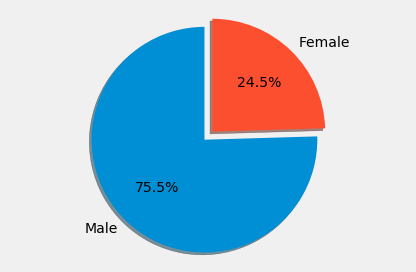

In [1160]:
#Pie chart for gender
fig,ax=plt.subplots()
ax.pie(bf['Gender'].value_counts(),explode=explode,labels=['Male','Female'],autopct='%1.1f%%',shadow=True,startangle=90)
ax.axis('equal')
plt.tight_layout()

Males account for 75.4 % of shoppers

Females account 24.6% of shoppers

## 2.1.8 Age 

In [1161]:
#Age count by percentage
bf['Age'].value_counts(normalize=True)*100

26-35    39.937125
36-45    20.016695
18-25    18.116035
46-50     8.296963
51-55     6.994589
55+       3.887588
0-17      2.751005
Name: Age, dtype: float64

In [1162]:
# Barplot for age
bf['Age'].value_counts().iplot(kind='bar',xTitle='Age group',yTitle='count',color='rgb(0,255,255)',title='Age distribution')

Age group 26-35 accounts the most shoppers with 39.9 %

Age group 0-17 is the group with the least shoppers at 2.7 %

## 2.1.9.Stay in current city 

In [1163]:
#Barplot for stay in current city
bf['Stay_In_Current_City_Years'].value_counts().iplot(kind='bar',xTitle='Years',yTitle='count',color='rgb(0,0,255)',title='Stay in city distribution')

In [1164]:
#Count of stay in current city years in percentage
bf['Stay_In_Current_City_Years'].value_counts(normalize=True)*100

1     35.147572
2     18.468543
3     17.439619
4+    15.438275
0     13.505991
Name: Stay_In_Current_City_Years, dtype: float64

Those who have stayed for one are the most at 35 %

Those  who have arrived have the least at 13.5 %

## 2.1.10 City category

In [1165]:
#Count of city category by percentage
bf['City_Category'].value_counts(normalize=True)*100

B    42.115653
C    31.029087
A    26.855260
Name: City_Category, dtype: float64

In [1166]:
#barplot of city category
bf['City_Category'].value_counts().iplot(kind='bar',title='City',xTitle='City',yTitle='Count',color='rgb(255,255,20)')

city B has most shoppers at 42%
city A has the least at 26%

## 2.1.11.Product 

In [1167]:
#Top ten products
bf['Product_ID'].value_counts(normalize=True).head(10)*100

P00265242    0.348090
P00110742    0.297400
P00025442    0.294377
P00112142    0.287401
P00057642    0.264846
P00046742    0.263218
P00184942    0.261823
P00237542    0.260893
P00058042    0.260893
P00059442    0.260428
Name: Product_ID, dtype: float64

In [1168]:
#Plot of top ten products
bf['Product_ID'].value_counts().head(10).iplot(kind='bar',title='Top Ten Product',xTitle='Product_id',yTitle='count')

## 2.1.12 user

In [1169]:
bf['User_ID'].value_counts().head(10)

1001680    828
1004277    804
1001941    715
1001181    699
1000889    657
1003618    602
1001150    595
1002909    583
1001015    578
1002063    575
Name: User_ID, dtype: int64

Text(0, 0.5, 'count')

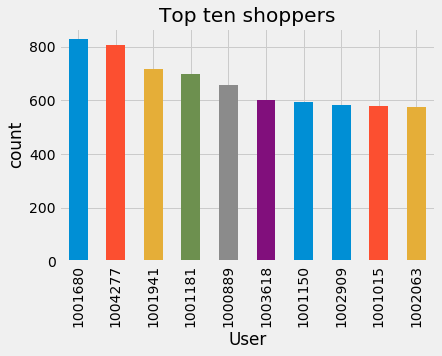

In [1170]:
#Barplot of top ten shoppers
bf['User_ID'].value_counts().head(10).plot(kind='bar',title='Top ten shoppers')
plt.xlabel('User')
plt.ylabel('count')

# 2.2 Bivariate Analysis

## 2.2.1 Age and Purchase

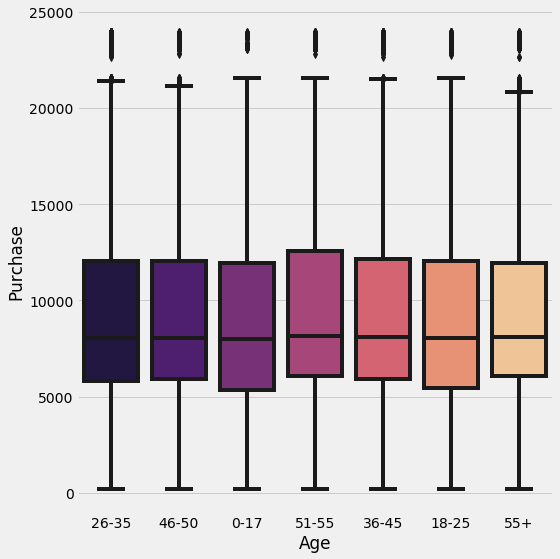

In [1171]:
#Boxplot of Age and purchase
fig=plt.figure(figsize=(8,8))
sns.boxplot(data=bf,x='Age',y='Purchase',palette='magma')
plt.tight_layout()

In [1172]:
#Mean purchase grouped by age
bf.groupby('Age')['Purchase'].mean().sort_values(ascending=False)

Age
51-55    9627.287058
55+      9439.931276
36-45    9411.266670
26-35    9316.120061
46-50    9291.662827
18-25    9235.587640
0-17     9040.684304
Name: Purchase, dtype: float64

In [1173]:
#Median purchase grouped by age
bf.groupby('Age')['Purchase'].median().sort_values(ascending=False)

Age
51-55    8163.0
55+      8125.0
36-45    8080.0
46-50    8051.5
26-35    8045.0
18-25    8040.0
0-17     8013.0
Name: Purchase, dtype: float64

Age group 51-55 has the highest mean  despite accounting 7% of shoppers

Age group 26-35 is the most popular age group of shoppers but they are the 4th in purchase power

Age group 0-17 has the lowest mean and median

In [1174]:
#Interquatile range for age groups based on purchase
ag=['0-17','18-25','26-35','46-50','36-45','55+','51-55']
for t in ag:
    w=bf[bf['Age']==t]['Purchase']
    s=iqr(w)
    print('Interquatile range for age group {Age} is {result}'.format(Age=t,result=s))

Interquatile range for age group 0-17 is 6572.0
Interquatile range for age group 18-25 is 6599.0
Interquatile range for age group 26-35 is 6233.0
Interquatile range for age group 46-50 is 6102.0
Interquatile range for age group 36-45 is 6240.0
Interquatile range for age group 55+ is 5905.0
Interquatile range for age group 51-55 is 6530.0


In [1175]:
#Max purchase by each age group
bf.groupby('Age')['Purchase'].max()

Age
0-17     23955
18-25    23958
26-35    23961
36-45    23960
46-50    23960
51-55    23960
55+      23960
Name: Purchase, dtype: int64

In [1176]:
#Min purchase by each age group
bf.groupby('Age')['Purchase'].min()

Age
0-17     197
18-25    193
26-35    185
36-45    185
46-50    186
51-55    187
55+      187
Name: Purchase, dtype: int64

Age group 18-25 has the highest variability

Age group 55+ has the lowest variability

## 2.2.2 Gender vs Purchase 

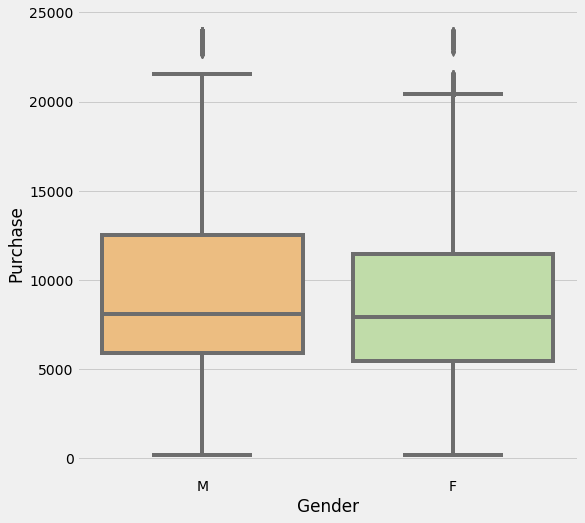

In [1177]:
#Boxplot for gender and purchase
fig=plt.figure(figsize=(8,8))
sns.boxplot(data=bf,x='Gender',y='Purchase',palette='Spectral')

In [1178]:
#Interquatile range for genders based on purchase
g=['M','F']
for t in g:
    s=bf[bf['Gender']==t]['Purchase']
    q=iqr(s)
    print('Interquatile range for {t} is {value}'.format(t=t,value=q))

Interquatile range for M is 6630.0
Interquatile range for F is 5989.0


In [1179]:
bf.groupby('Gender')['Purchase'].mean().iplot(kind='bar',title='Purchase power among gender',xTitle='Gender',yTitle='Purchase')

Although females account 24.6% of the shoppers and males 76.4% their difference in purchase mean is 664

Females have more outliers

Males have a higher iqr

### 2.2.2.1 Hypothesis testing

Null hyp.There is no difference in mean purchase of items of a particular gender

Alt hyp.There is a difference in mean purchase of items of a particular gender

In [1180]:
from scipy import stats
#Find zscores for purchase
data=np.abs(stats.zscore(bf['Purchase']))

In [1181]:
'''Seperate the genders then save their values
in a list.Procced and sample 100 males and 100 females then perform 
an independent ttest'''

gen_f=bf[bf['Gender']=='F']['Purchase']
gen_m=bf[bf['Gender']=='M']['Purchase']
gen_f=gen_f.values.tolist()
gen_f=random.sample(gen_f,100)
gen_m=gen_m.values.tolist()
gen_m=random.sample(gen_m,100)

In [1182]:
ttest,pval = ttest_ind(gen_f,gen_m,equal_var = False)
print("ttest",ttest)
print('p value',pval)
if pval<0.05:
    print('Null hypothesis rejected')
else:
    print('Alternative hypothesis accepted')
    

ttest -0.47958256769405805
p value 0.6320539160148018
Alternative hypothesis accepted


## 2.2.3 Status vs purchase

In [1183]:
#Count marital status by percentage
#0 represents single
#1 represents married
bf['Marital_Status'].value_counts(normalize=True)*100

0    59.147423
1    40.852577
Name: Marital_Status, dtype: float64

In [1184]:
#Plot Marital status purchase mean
bf.groupby('Marital_Status')['Purchase'].mean().iplot(kind='bar',title='Purchase among the status',color='rgb(100,0,100)',xTitle='Gender',yTitle='Purchase')

Both have almost the same means though the married account about 40%

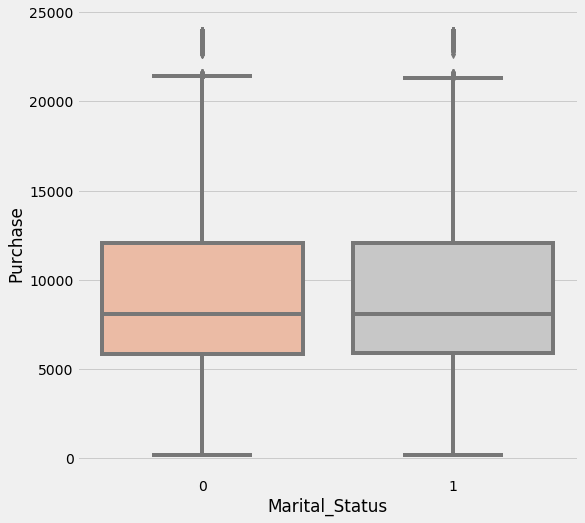

In [1185]:
#Boxplot for status and purchase
fig=plt.figure(figsize=(8,8))
sns.boxplot(data=bf,x='Marital_Status',y='Purchase',palette='RdGy')

In [1186]:
#Interquatile range
g=[0,1]
for t in g:
    s=bf[bf['Marital_Status']==t]['Purchase']
    q=iqr(s)
    print('Interquatile range for {t} is {value}'.format(t=t,value=q))

Interquatile range for 0 is 6230.0
Interquatile range for 1 is 6178.0


### 2.2.3.1 Hypothesis testing

Null hypothesis.There is no statistical difference between status and purchase

Alt hypothesis.There is a statistical difference between status and purchase

In [1187]:
data=np.abs(stats.zscore(bf['Purchase']))

In [1188]:
'''Seperate the marital statuses then save their values
in a list.Procced and sample 100 singles and 100 married then perform 
an independent ttest'''
status_un=bf[bf['Marital_Status']==0]['Purchase']
status_m=bf[bf['Marital_Status']==1]['Purchase']
status_un=status_un.values.tolist()
status_un=random.sample(status_un,100)
status_m=status_m.values.tolist()
status_m=random.sample(status_m,100)

In [1189]:
ttest,pval = ttest_ind(status_un,status_m,equal_var = False)
print("ttest",ttest)
print('p value',pval)
if pval<0.05:
    print('Null hypothesis rejected')
else:
    print('Alternative hypothesis accepted')
    

ttest -0.7754060735200877
p value 0.4390413083913681
Alternative hypothesis accepted


## 2.2.4 City category vs Purchase 

In [1190]:
#Barplot of city and purchase
bf.groupby('City_Category')['Purchase'].mean().iplot(kind='bar',title='City vs Purchase',xTitle='city',yTitle='mean',color='rgb(200,200,255)')

City C leads with a mean of 9844

City A is the least with a mean of 8958

In [1191]:
#Interquatile range for cities
g=['A','B','C']
for t in g:
    s=bf[bf['City_Category']==t]['Purchase']
    q=iqr(s)
    print('Interquatile range for {t} is {value}'.format(t=t,value=q))

Interquatile range for A is 6375.0
Interquatile range for B is 6525.5
Interquatile range for C is 7191.0


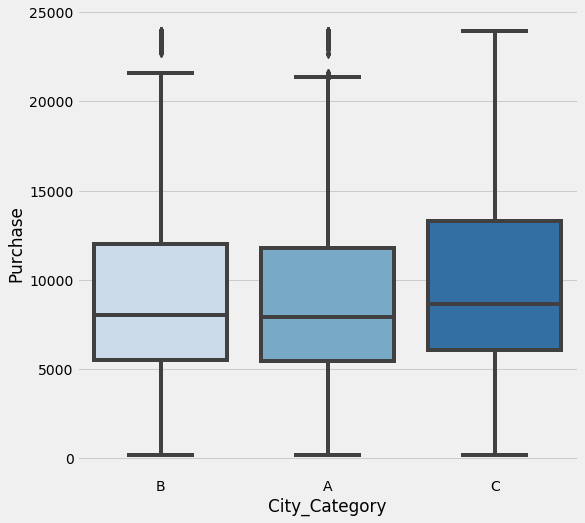

In [1192]:
#Boxplot for purchase and city
fig=plt.figure(figsize=(8,8))
sns.boxplot(data=bf,x='City_Category',y='Purchase',palette='Blues')

City A and B have outliers

City C has a high iqr

## 2.2.5 Occupation vs Purchase 

In [1193]:
#Occupation count in terms of percentage
bf['Occupation'].value_counts(normalize=True)*100

4     13.184874
0     12.611234
7     10.759171
1      8.579713
17     7.297104
20     6.087741
12     5.665475
14     4.953251
2      4.823502
16     4.599813
6      3.694360
3      3.228379
10     2.360828
5      2.216197
15     2.190852
11     2.139696
19     1.561639
13     1.402359
18     1.209131
9      1.154487
8      0.280193
Name: Occupation, dtype: float64

In [1194]:
#Occupation and purchase mean
bf.groupby('Occupation')['Purchase'].mean().sort_values(ascending=False)

Occupation
17    9922.420177
15    9865.986415
12    9851.871045
8     9581.325311
14    9558.486480
7     9507.597718
16    9473.837832
13    9394.429116
5     9379.897283
6     9316.115999
4     9288.157452
11    9273.312867
18    9242.421731
0     9208.389280
3     9183.923797
10    9084.035753
1     9044.500298
2     9017.169109
20    8889.696421
19    8742.268463
9     8722.097684
Name: Purchase, dtype: float64

In [1195]:
#Occupation and purchase mean
bf.groupby('Occupation')['Purchase'].mean().iplot(kind='bar',title='occupation vs purchase',color='rgb(200,100,255)',xTitle='Occupation',yTitle='mean')

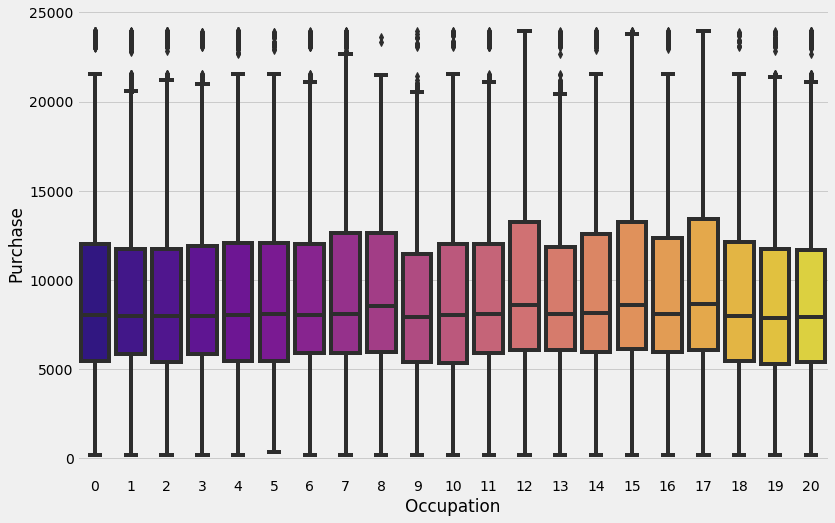

In [1196]:
#Occupation and purchase boxplot
fig=plt.figure(figsize=(12,8))
sns.boxplot(data=bf,x='Occupation',y='Purchase',palette='plasma')

1.Occupation 8 has a highest purchase power considering they are they account for 0.2% of shoppers but their purchase surpass that of occupation 4 accounting 13% of the shoppers.

2.One person in occupation 8 does purchase equal to 46 from occupation 4

3.The two occupations(8 and 18) with the least number of people have a higher purchase power than the 2 most populous occupation(4 and 0)


## 2.2.6 Product category 1 and purchase 

In [1197]:
#Product category 1 purchase mean and plot
bf.groupby('Product_Category_1')['Purchase'].mean().sort_values(ascending=False)

Product_Category_1
10    19692.372988
7     16372.034411
6     15824.176791
9     15449.072072
15    14785.949071
16    14753.149055
1     13609.555647
14    13143.373754
2     11261.077739
17    10249.247727
3     10088.134620
8      7495.147990
5      6236.888217
11     4690.310876
18     2966.516510
4      2333.488282
12     1352.900288
13      723.152394
Name: Purchase, dtype: float64

In [1198]:
bf.groupby('Product_Category_1')['Purchase'].mean().iplot(kind='bar',title='Purchase vs product 1',xTitle='Product',yTitle='mean',color='rgb(60,90,60)')

1.Product 1,5 and 8 were the most common but not the highest spent on

2.Product 9 is the least popular(0.07%) but the third most spent on product while product 5 is the most common at 27% but the 13th most spent on product

3.Product 10 is the highest spent on but the 6th least popular  product(3.7%)

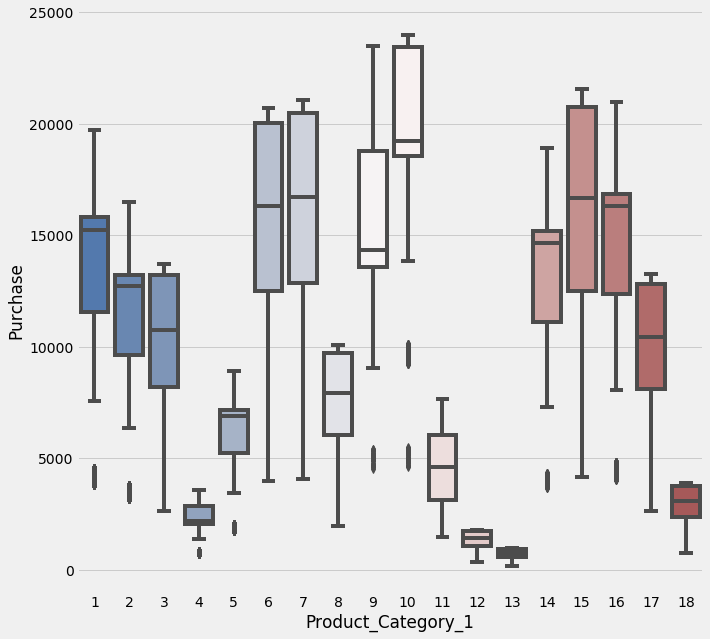

In [1199]:
#Boxplot of purchase and product category 1
fig=plt.figure(figsize=(10,10))
sns.boxplot(data=bf,x='Product_Category_1',y='Purchase',palette='vlag')

## 2.2.7 Product 2 vs purchase 

In [1200]:
#Product category 2 count in terms of percentage
bf['Product_Category_2'].value_counts(normalize=True).sort_values(ascending=False)*100

8.0     17.000559
14.0    14.628482
2.0     13.145513
16.0    11.504135
15.0    10.054533
5.0      6.946364
4.0      6.765374
6.0      4.392960
11.0     3.757305
17.0     3.566204
13.0     2.774501
9.0      1.521055
12.0     1.464095
10.0     0.811589
3.0      0.766763
18.0     0.741485
7.0      0.159082
Name: Product_Category_2, dtype: float64

In [1201]:
#Product category 2 purchase means and its barplot
bf.groupby('Product_Category_2')['Purchase'].mean().sort_values(ascending=False)

Product_Category_2
10.0    15618.980482
2.0     13619.626054
6.0     11497.425503
3.0     11248.997363
15.0    10355.312919
16.0    10311.033106
8.0     10298.871811
4.0     10199.230708
13.0     9686.052114
17.0     9438.343257
18.0     9385.860000
5.0      9047.581223
11.0     8896.154647
9.0      7259.924884
14.0     7102.455084
12.0     6967.078269
7.0      6794.557203
Name: Purchase, dtype: float64

In [1202]:
bf.groupby('Product_Category_2')['Purchase'].mean().iplot(kind='bar',title='product 2 vs purchase',xTitle='Product 2',yTitle='mean',color='rgb(10,100,146)')

1.Product 10 is the most spent on but the least popular at 0.8%

2.Product 7 is the least popular and the least spent on

3.Product 14 is the 2nd most popular product but the third last spent on

4.Product 9 and 12 are among the least spent on and least popular

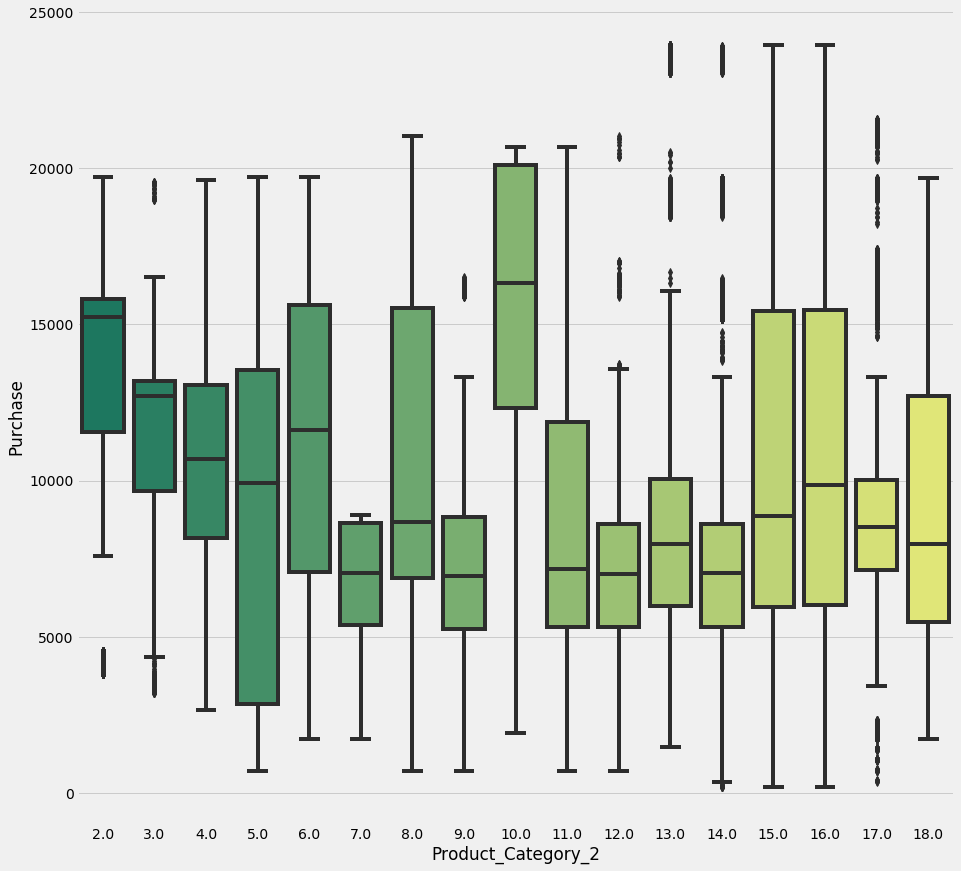

In [1203]:
#Boxplot for product category 2 and purchase
fig=plt.figure(figsize=(14,14))
sns.boxplot(data=bf,x='Product_Category_2',y='Purchase',palette='summer')

## 2.2.8 Product 3 vs Purchase 

In [1204]:
#Value counts for category 3 in terms of percentage
bf['Product_Category_3'].value_counts(normalize=True).sort_values(ascending=False)*100

16.0    19.585959
15.0    16.829237
14.0    10.999521
17.0    10.028662
5.0      9.986087
8.0      7.544114
9.0      6.926779
12.0     5.504322
13.0     3.278265
6.0      2.951351
18.0     2.741517
4.0      1.130515
11.0     1.081858
10.0     1.045365
3.0      0.366448
Name: Product_Category_3, dtype: float64

In [1205]:
#product category 3 with their means and barplot
bf.groupby('Product_Category_3')['Purchase'].mean().sort_values(ascending=False)

Product_Category_3
3.0     13972.114108
10.0    13564.955636
13.0    13180.147959
6.0     13172.026018
8.0     13020.159024
15.0    12347.356207
11.0    12145.049192
5.0     12129.240502
16.0    11975.116839
17.0    11817.166326
18.0    10939.806156
9.0     10412.580397
14.0    10065.248825
4.0      9724.426362
12.0     8719.576105
Name: Purchase, dtype: float64

In [1206]:
bf.groupby('Product_Category_3')['Purchase'].mean().iplot(kind='bar',xTitle='Product 3',title='Product 3 vs Purchase',yTitle='mean',color='rgb(200,155,56)')

1.Product 3 is the least popular at 0.3 but the most spent on

2.Product 10 is the second least popular at 1% but the second most spent on item

3.Product 16 is the most popular at 19.5 % but the 9th most spent on product

4.Product 12 is moderately popular but least spent on

5.Product 6 is the 9th most popular product and the third most spent on

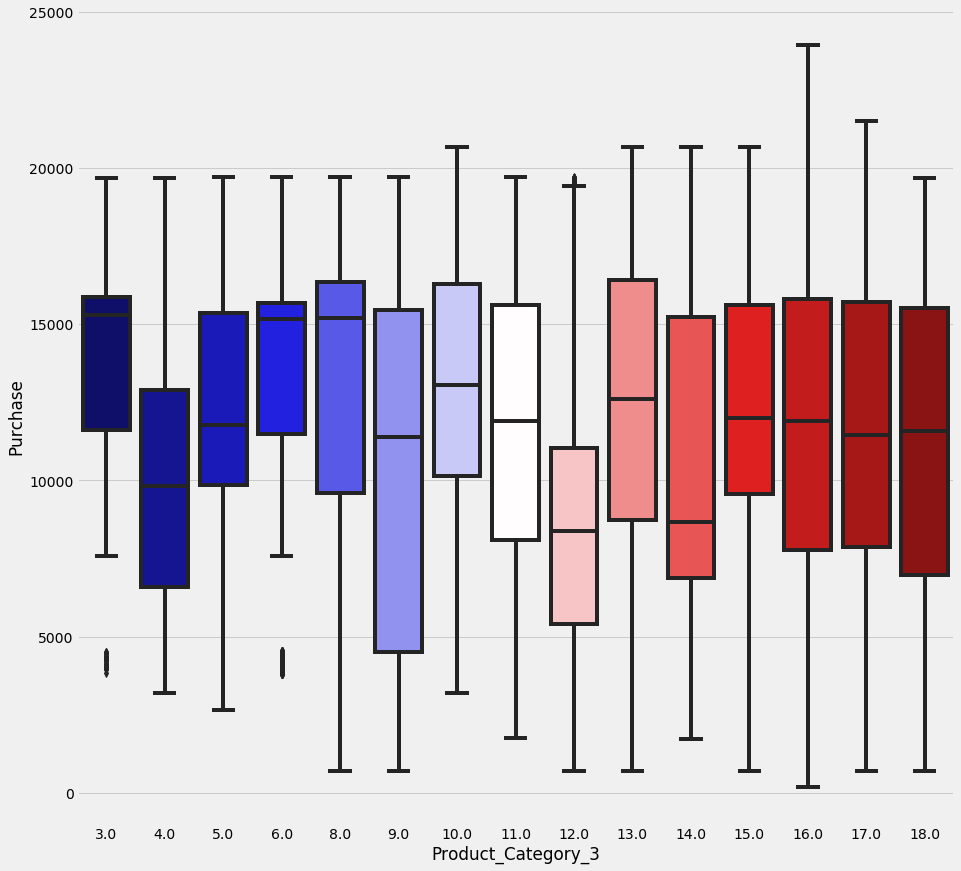

In [1207]:
#boxplot for product 3 and purchase
fig=plt.figure(figsize=(14,14))
sns.boxplot(data=bf,x='Product_Category_3',y='Purchase',palette='seismic')

## 2.2.9Stay in current city  vs purchase 

In [1208]:
#Count of Stay in terms of percentage
bf['Stay_In_Current_City_Years'].value_counts(normalize=True)*100

1     35.147572
2     18.468543
3     17.439619
4+    15.438275
0     13.505991
Name: Stay_In_Current_City_Years, dtype: float64

In [1209]:
#Mean purchase by various number of stay in city and barplot
bf.groupby('Stay_In_Current_City_Years')['Purchase'].mean().sort_values(ascending=False)

Stay_In_Current_City_Years
2     9394.647886
4+    9365.134274
3     9364.757337
1     9318.684267
0     9241.888437
Name: Purchase, dtype: float64

In [1210]:
bf.groupby('Stay_In_Current_City_Years')['Purchase'].mean().iplot(kind='bar',title='Stay vs Purchase',xTitle='Stay',yTitle='mean',color='rgb(0,255,200)')

1.All seem to have same mean regardless of years in the city

# 2.2.10 Gender and age vs Purchase 

In [1211]:
'''Find the difference between males and females in all age groups'''
l=['0-17','18-25','26-35','36-45','46-50','51-55','55+']
for t in l:
    m=len(bf[(bf['Gender']=='M')&(bf['Age']==t)])
    f=len(bf[(bf['Gender']=='F')&(bf['Age']==t)])
    print('The difference btn males and females in age group{group} is {value}'.format(group=t,value=m-f))
    
    

The difference btn males and females in age group0-17 is 3927
The difference btn males and females in age group18-25 is 39644
The difference btn males and females in age group26-35 is 92994
The difference btn males and females in age group36-45 is 43776
The difference btn males and females in age group46-50 is 15210
The difference btn males and females in age group51-55 is 14719
The difference btn males and females in age group55+ is 8779


/home/lytica/anaconda3/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning:

Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.



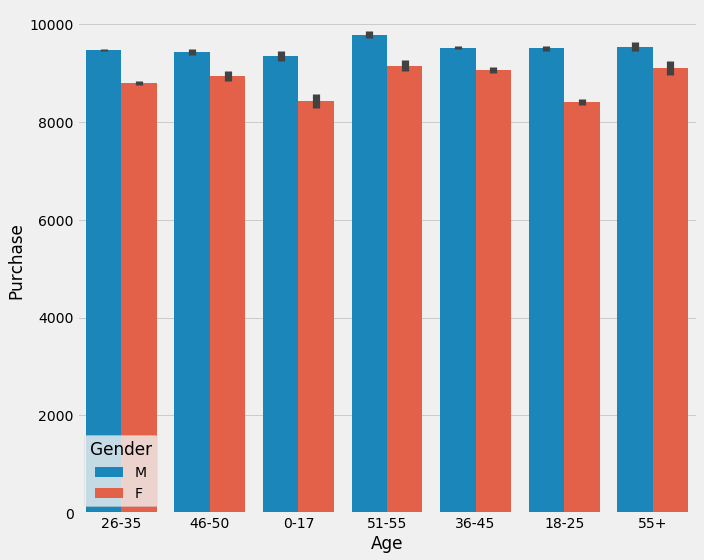

In [1212]:
'''Compare the purchase between males and female between all age groups'''
fig=plt.figure(figsize=(10,8))
sns.barplot(data=bf,x='Age',y='Purchase',hue='Gender')
plt.tight_layout()

1.For every age group M purchase more

2.M 55+ purchase the most while F between 51-55 purchase more

## 2.2.12 Gender ,Age,Status and product 1 vs Purchase 

In [1213]:
'''Single out age group 26-35 and find percentage each marital status 
contributes to this age group'''
t=bf[bf['Age']=='26-35']
t['Marital_Status'].value_counts(normalize=True)*100

0    60.761321
1    39.238679
Name: Marital_Status, dtype: float64

In [1214]:
#Find single females in age 26-35
single_female=bf[(bf['Age']=='26-35')&(bf['Marital_Status']==0)&(bf['Gender']=='F')]

In [1215]:
#value count for single females in age 26-35
value_count_females=single_female['Product_Category_1'].value_counts()

In [1216]:

purchase_by_female=single_female.groupby('Product_Category_1')['Purchase'].mean().sort_values(ascending=False)

In [1217]:
purchase_by_female

Product_Category_1
10    19589.631250
9     17113.333333
7     16344.056604
6     15565.134474
16    14624.740741
15    14499.167742
14    13955.152542
1     13446.197752
2     11212.478312
3     10239.004825
17     8043.666667
8      7422.250245
5      6224.380256
11     4735.057564
18     2728.761905
4      2499.790698
12     1420.056995
13      717.522124
Name: Purchase, dtype: float64

In [1218]:
#barplot of product category 1 and mean for single females in age 26-35
single_female.groupby('Product_Category_1')['Purchase'].mean().iplot(kind='bar',title='product 1 purchase based on single females in age 26-35',xTitle='Product 1',yTitle='mean',color='rgb(23,45,67)')

In [1219]:
'''Single out males in age 25-35 who are single and find their count then plot a barplot for product category 1'''
single_male=bf[(bf['Age']=='26-35')&(bf['Marital_Status']==0)&(bf['Gender']=='M')]
value_count_male=single_male['Product_Category_1'].value_counts()

In [1220]:
single_male.groupby('Product_Category_1')['Purchase'].mean().iplot(kind='bar',title='product 1 purchase based on single males in age 26-35',xTitle='Product')

In [1221]:
value_count_females=value_count_females.reset_index()

In [1222]:
value_count_females.rename({'Product_Category_1':'most shopped item by females','index':'Product category'},axis=1,inplace=True)

In [1223]:
value_count_females

,Product category,most shopped item by females
0,5,7800
1,8,6122
2,1,4182
3,2,853
4,3,829
5,6,818
6,11,747
7,4,559
8,16,459
9,13,226


In [1365]:
#Value count
value_count_male=value_count_male.reset_index()

In [1366]:
#rename columns
value_count_male.rename({'Product_Category_1':'most shopped item by male','index':'Product category'},axis=1,inplace=True)

In [1226]:
value_count_male

,Product category,most shopped item by male
0,1,23511
1,5,21909
2,8,15464
3,11,3822
4,2,3343
5,6,3302
6,3,2629
7,16,1478
8,4,1413
9,15,967


In [1227]:
value_count_females

,Product category,most shopped item by females
0,5,7800
1,8,6122
2,1,4182
3,2,853
4,3,829
5,6,818
6,11,747
7,4,559
8,16,459
9,13,226


In [1228]:
'''Merge value counts for males and females then find the difference in popularity of each 
product among them'''
merge_v=pd.merge(value_count_male,value_count_females,on='Product category')
merge_v['difference']=merge_v['most shopped item by male']-merge_v['most shopped item by females']

In [1229]:
merge_v

,Product category,most shopped item by male,most shopped item by females,difference
0,1,23511,4182,19329
1,5,21909,7800,14109
2,8,15464,6122,9342
3,11,3822,747,3075
4,2,3343,853,2490
5,6,3302,818,2484
6,3,2629,829,1800
7,16,1478,459,1019
8,4,1413,559,854
9,15,967,155,812


Text(0.5, 1.0, 'Most shopped item difference between single males and single females in category 1')

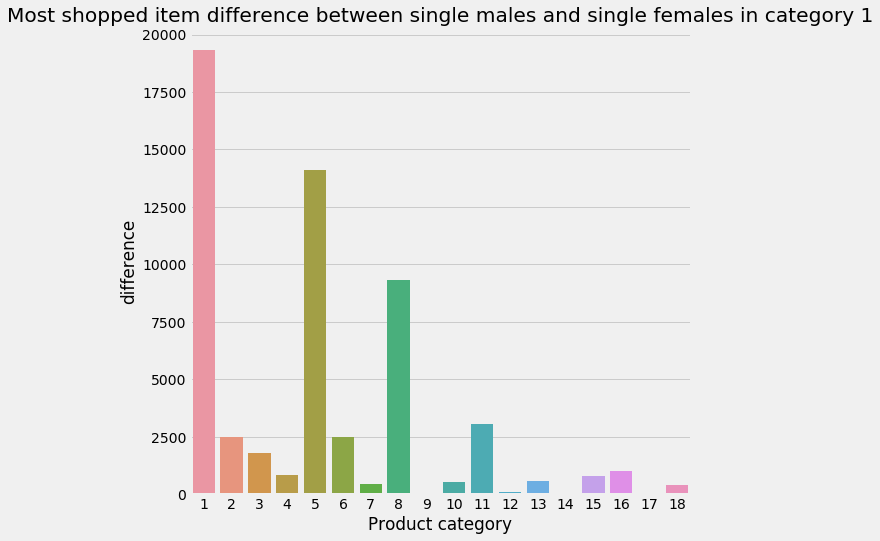

In [1230]:

fig=plt.figure(figsize=(8,8))
sns.barplot(data=merge_v,x='Product category',y='difference')
plt.title('Most shopped item difference between single males and single females in category 1')

In [1231]:
purchase_by_male=single_male.groupby('Product_Category_1')['Purchase'].mean().sort_values(ascending=False)

In [1232]:
purchase_by_male

Product_Category_1
10    19637.816716
7     16282.342857
6     15897.484858
9     15327.784615
16    14750.627876
15    14629.568769
1     13511.898218
14    12192.227848
2     11000.154352
17    10490.944444
3     10135.496006
8      7416.233639
5      6168.580446
11     4705.535583
18     3078.728311
4      2268.698514
12     1296.118033
13      728.041878
Name: Purchase, dtype: float64

In [1233]:
#Reset index
purchase_by_female=purchase_by_female.reset_index()
purchase_by_male=purchase_by_male.reset_index()

In [1234]:
purchase_by_male.rename({'Purchase':'Purchase mean of product by male'},axis=1,inplace=True)

In [1235]:
purchase_by_female.rename({'Purchase':'Purchase mean of product by female'},axis=1,inplace=True)


In [1236]:
merge_2=pd.merge(purchase_by_male,purchase_by_female,on='Product_Category_1')

In [1237]:
merge_2['difference']=merge_2['Purchase mean of product by male']-merge_2['Purchase mean of product by female']

In [1238]:
merge_2

,Product_Category_1,Purchase mean of product by male,Purchase mean of product by female,difference
0,10,19637.816716,19589.631250,48.185466
1,7,16282.342857,16344.056604,-61.713747
2,6,15897.484858,15565.134474,332.350383
3,9,15327.784615,17113.333333,-1785.548718
4,16,14750.627876,14624.740741,125.887135
5,15,14629.568769,14499.167742,130.401027
6,1,13511.898218,13446.197752,65.700466
7,14,12192.227848,13955.152542,-1762.924694
8,2,11000.154352,11212.478312,-212.323959
9,17,10490.944444,8043.666667,2447.277778


In [1239]:
mm=merge_2[merge_2['difference']>0]
mm

,Product_Category_1,Purchase mean of product by male,Purchase mean of product by female,difference
0,10,19637.816716,19589.631250,48.185466
2,6,15897.484858,15565.134474,332.350383
4,16,14750.627876,14624.740741,125.887135
5,15,14629.568769,14499.167742,130.401027
6,1,13511.898218,13446.197752,65.700466
9,17,10490.944444,8043.666667,2447.277778
14,18,3078.728311,2728.761905,349.966406
17,13,728.041878,717.522124,10.519754


In [1240]:
fm=merge_2[merge_2['difference']<0]
fm['difference']=np.abs(fm['difference'])

/home/lytica/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



Text(0.5, 1.0, 'Products single male purchased more than  single females')

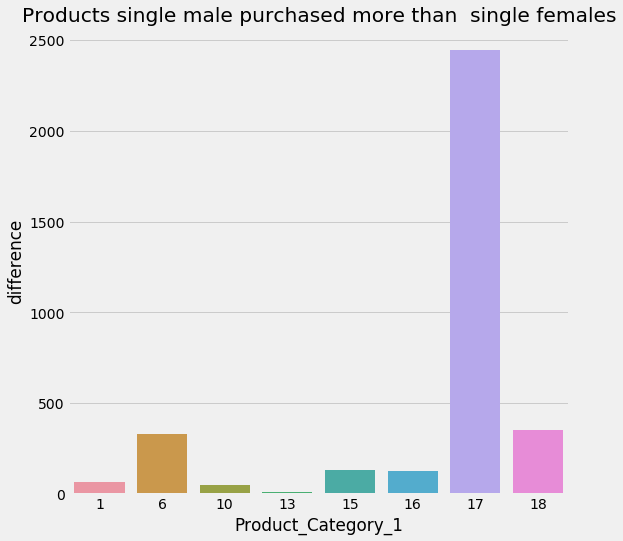

In [1241]:
fig=plt.figure(figsize=(8,8))
sns.barplot(data=mm,x='Product_Category_1',y='difference')
plt.title('Products single male purchased more than  single females')

Text(0.5, 1.0, 'Products single female purchased more thans single  males')

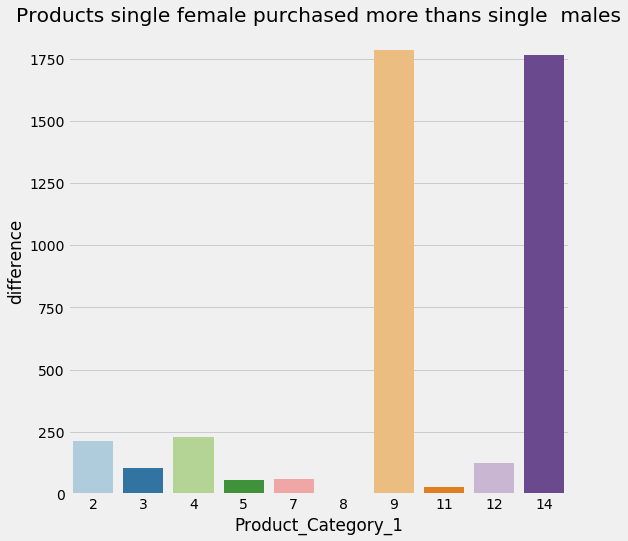

In [1242]:
fig=plt.figure(figsize=(8,8))
sns.barplot(data=fm,x='Product_Category_1',y='difference',palette='Paired')
plt.title('Products single female purchased more thans single  males')

In [1363]:
'''Single out shoppers in group 26-35 by status and gender'''
mar_f=bf[(bf['Age']=='26-35')&(bf['Marital_Status']==1)&(bf['Gender']=='F')]
mar_m=bf[(bf['Age']=='26-35')&(bf['Marital_Status']==1)&(bf['Gender']=='M')]

In [1364]:
#Value count
vc_mar_f=mar_f['Product_Category_1'].value_counts()
vc_mar_m=mar_m['Product_Category_1'].value_counts()

In [1245]:
vc_mar_f

5     5161
8     3813
1     3197
3      609
2      593
11     571
6      556
4      353
16     300
13     156
7      142
10     129
12     127
15     123
14      63
18      39
9        9
17       2
Name: Product_Category_1, dtype: int64

In [1246]:
vc_mar_m

1     15149
5     13588
8      9466
11     2595
2      2216
6      1985
3      1895
16      993
4       987
15      613
13      452
10      415
7       376
18      318
12      215
14      106
17       42
9        40
Name: Product_Category_1, dtype: int64

In [1247]:
pbmf=mar_f.groupby(['Product_Category_1'])['Purchase'].mean().sort_values(ascending=False)

In [1248]:
mar_f.groupby(['Product_Category_1'])['Purchase'].mean().iplot(kind='bar',title='Product 1 purchase by married Females',yTitle='mean',xTitle='Category',color='rgb(100,25,100)')

In [1249]:
pbmm=mar_m.groupby(['Product_Category_1'])['Purchase'].mean().sort_values(ascending=False)

In [1250]:
mar_m.groupby(['Product_Category_1'])['Purchase'].mean().iplot(kind='bar',title='Product 1 purchase by married males',yTitle='mean',xTitle='Category',color='rgb(100,255,100)')

In [1362]:
#Reset index
pbmm=pbmm.reset_index()

In [1361]:
#Reset index
pbmf=pbmf.reset_index()

In [1253]:
pbmm

,Product_Category_1,Purchase
0,10,19238.108434
1,7,16432.244681
2,9,15943.150000
3,6,15684.167758
4,16,14507.013092
5,15,14278.030995
6,1,13353.448214
7,14,12283.811321
8,2,11004.788357
9,3,10022.362533


In [1254]:
pbmf

,Product_Category_1,Purchase
0,10,19974.131783
1,7,16447.345070
2,6,15292.715827
3,16,15155.940000
4,9,15064.000000
5,15,14558.317073
6,1,13865.441038
7,14,13241.507937
8,2,11672.709949
9,3,10436.512315


In [1255]:
merge_3=pd.merge(pbmf,pbmm,on='Product_Category_1',suffixes=('_by females','_by males'))
merge_3['difference']=merge_3['Purchase_by males']-merge_3['Purchase_by females']


In [1256]:
fd=merge_3[merge_3['difference']>0]

Text(0.5, 1.0, 'Products married females purchased more than married males')

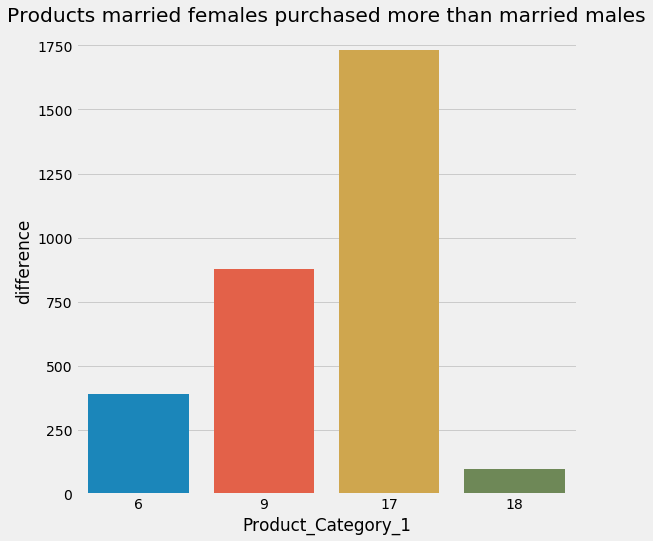

In [1257]:
fig=plt.figure(figsize=(8,8))
sns.barplot(data=fd,x='Product_Category_1',y='difference')
plt.title('Products married females purchased more than married males')

Text(0.5, 1.0, 'Products married males purchased more than married females')

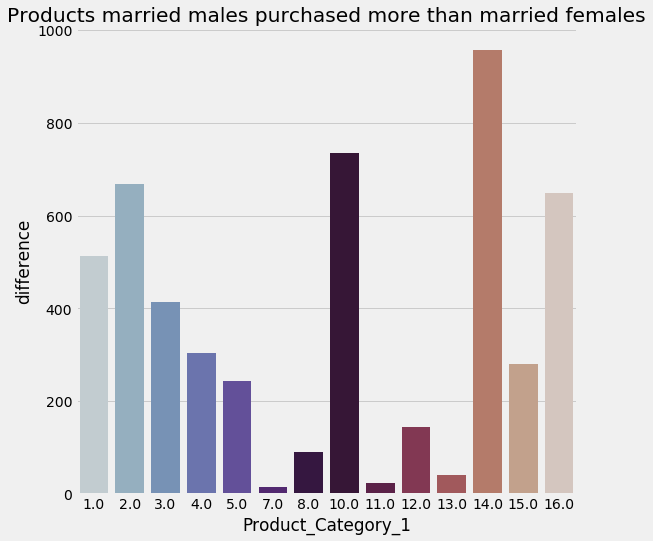

In [1360]:
#convert the negative value to positive
md=np.abs(merge_3[merge_3['difference']<0])
plt.figure(figsize=(8,8))
sns.barplot(data=md,x='Product_Category_1',y='difference',palette='twilight')
plt.title('Products married males purchased more than married females')

1.Product 10 is the most spent on by both single and married malea and females in age 26-35

2.Product 13 is the least spent on by both genders whether married or not

3.Single males spent more on product 1,6,9,10,13,16,17 and 18

4.Single females spent more in the rest.

5.Product 10 is the most bought product by all genders and marital status

6.Males shopped more of product 1,5,8 and 12 but females spent more on it

7.Married females spent more on product 6,9,17 and 18 only.

8.Married males spent more on the rest

## 2.2.11 Occupation ,Status,Gender vs Purchase

In [1259]:
vc_male=bf[bf['Gender']=='M']['Occupation'].value_counts()

In [1260]:
vc_male

4     42892
0     40258
7     38528
17    28377
1     23008
12    21641
20    19363
16    16611
14    15968
2     13983
6      9468
11     8039
5      7819
3      7653
15     7591
10     7031
19     5143
18     5034
13     4856
8       929
9       363
Name: Occupation, dtype: int64

In [1261]:
vc_female=bf[bf['Gender']=='F']['Occupation'].value_counts()

In [1262]:
vc_female

0     13978
1     13890
4     13811
7      7743
20     6818
2      6761
6      6420
3      6231
14     5334
9      4602
16     3171
10     3122
17     3005
12     2724
15     1831
5      1712
19     1573
13     1175
11     1163
8       276
18      166
Name: Occupation, dtype: int64

In [1263]:
vc_female=vc_female.reset_index()
vc_male=vc_male.reset_index()

In [1264]:
merge=pd.merge(vc_male,vc_female,on='index',suffixes=('_male','_female'))
merge['difference']=merge['Occupation_male']-merge['Occupation_female']

In [1265]:
merge

,index,Occupation_male,Occupation_female,difference
0,4,42892,13811,29081
1,0,40258,13978,26280
2,7,38528,7743,30785
3,17,28377,3005,25372
4,1,23008,13890,9118
5,12,21641,2724,18917
6,20,19363,6818,12545
7,16,16611,3171,13440
8,14,15968,5334,10634
9,2,13983,6761,7222


In [1266]:
ocm=merge[merge['difference']>0]
ocf=np.abs(merge[merge['difference']<0])

Text(0.5, 1.0, 'Occupations with more males than females')

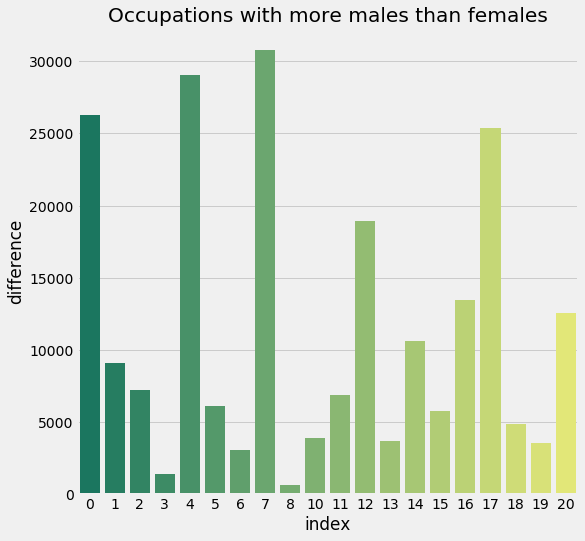

In [1267]:
fig=plt.figure(figsize=(8,8))
sns.barplot(data=ocm,x='index',y='difference',palette='summer')
plt.title('Occupations with more males than females')

Text(0.5, 1.0, 'Occupations with more females than males')

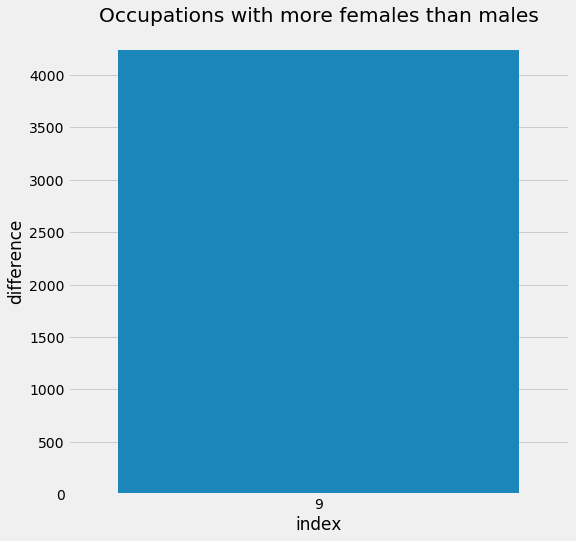

In [1268]:
fig=plt.figure(figsize=(8,8))
sns.barplot(data=ocf,x='index',y='difference')
plt.title('Occupations with more females than males')

1.Only occupation 9 had more females than males.Occupation 9 also has the lowest purchase mean

2.The smallest difference was from occupation 8.



##  2.2.12 Stay,Gender,Staus vs Purchase

In [1269]:
vc=bf.groupby('Stay_In_Current_City_Years')['Gender'].value_counts(normalize=True)

In [1270]:
vc

Stay_In_Current_City_Years  Gender
0                           M         0.773225
                            F         0.226775
1                           M         0.736749
                            F         0.263251
2                           M         0.761489
                            F         0.238511
3                           M         0.744243
                            F         0.255757
4+                          M         0.782872
                            F         0.217128
Name: Gender, dtype: float64

In [1271]:
male_purchase=bf[bf['Gender']=='M'].groupby('Stay_In_Current_City_Years')['Purchase'].mean()

In [1272]:
male_purchase

Stay_In_Current_City_Years
0     9407.706292
1     9486.628093
2     9572.150805
3     9562.283792
4+    9495.039344
Name: Purchase, dtype: float64

In [1273]:
male_purchase.iplot(kind='bar',title='Purchase by males among stay in city',color='rgb(20,221,45)',yTitle='Mean',xTitle='Category')

In [1274]:
mf=bf[bf['Gender']=='F'].groupby('Stay_In_Current_City_Years')['Purchase'].mean()

In [1275]:
mf

Stay_In_Current_City_Years
0     8676.506453
1     8848.667772
2     8827.939084
3     8789.961735
4+    8896.751526
Name: Purchase, dtype: float64

In [1276]:
mf.iplot(kind='bar',title='Purchase by females in stay in city',color='rgb(24,255,200)')

In [1277]:
mf=bf[bf['Marital_Status']==0].groupby('Stay_In_Current_City_Years')['Purchase'].mean()

In [1278]:
mf.iplot(kind='bar',title='Purchase by single among stay in city',xTitle='Stay',yTitle='mean')

In [1279]:
mq=bf[bf['Marital_Status']==1].groupby('Stay_In_Current_City_Years')['Purchase'].mean()

In [1280]:
mq.iplot(kind='bar',title='Purchase by the married among stay in city',xTitle='Stay',yTitle='mean',color='rgb(2,100,0)')

In [1281]:
bf[bf['Occupation']==8]['Stay_In_Current_City_Years'].value_counts(normalize=True)

1     0.610788
0     0.202490
2     0.097095
4+    0.089627
Name: Stay_In_Current_City_Years, dtype: float64

In [1282]:
bf[bf['Occupation']==18]['Stay_In_Current_City_Years'].value_counts(normalize=True)

1     0.320577
0     0.252115
4+    0.217115
2     0.138269
3     0.071923
Name: Stay_In_Current_City_Years, dtype: float64

In [1283]:
bf[bf['Occupation']==13]['Stay_In_Current_City_Years'].value_counts(normalize=True)

1     0.469905
4+    0.225502
2     0.112419
0     0.099818
3     0.092356
Name: Stay_In_Current_City_Years, dtype: float64

In [1359]:
bf[bf['Occupation']==9]['Stay_In_Current_City_Years'].value_counts(normalize=True)*100

1     39.758308
3     21.470292
2     15.246727
4+    14.320242
0      9.204431
Name: Stay_In_Current_City_Years, dtype: float64

1.Occupations with a high purchase power have stayed in the city for one year surpasing the 35% for the whole population

2.60 % of people in occupation 8 with the highest purchase power have stayed in the city for one year



## 2.2.13 Gender ,Age,Status and product 2 vs Purchase 

In [1291]:
'''Get single males and females in age 26-35 '''
single_female=bf[(bf['Age']=='26-35')&(bf['Marital_Status']==0)&(bf['Gender']=='F')]

In [1292]:
single_male=bf[(bf['Age']=='26-35')&(bf['Marital_Status']==0)&(bf['Gender']=='M')]

In [1293]:
value_count_females=single_female['Product_Category_2'].value_counts()

In [1294]:
value_count_females

14.0    3667
8.0     2992
16.0    1651
2.0     1525
15.0    1086
5.0     1038
4.0     1020
6.0      576
11.0     464
13.0     457
17.0     384
12.0     289
9.0      268
10.0     109
3.0      106
18.0      50
7.0       20
Name: Product_Category_2, dtype: int64

In [1295]:
value_count_males=single_male['Product_Category_2'].value_counts()

In [1296]:
value_count_males

8.0     9590
2.0     8089
14.0    7020
16.0    6875
15.0    6152
5.0     3925
4.0     3146
6.0     2738
11.0    2343
17.0    1994
13.0    1440
9.0      909
12.0     670
3.0      491
10.0     412
18.0     380
7.0       96
Name: Product_Category_2, dtype: int64

In [1297]:
value_count_male=value_count_males.reset_index()
value_count_female=value_count_females.reset_index()

In [1298]:
value_count_female

,index,Product_Category_2
0,14.0,3667
1,8.0,2992
2,16.0,1651
3,2.0,1525
4,15.0,1086
5,5.0,1038
6,4.0,1020
7,6.0,576
8,11.0,464
9,13.0,457


In [1299]:
merge_c=pd.merge(value_count_male,value_count_female,on='index',how='inner',suffixes=('_male','_female'))

In [1300]:
merge_c['difference']=merge_c['Product_Category_2_male']-merge_c['Product_Category_2_female']

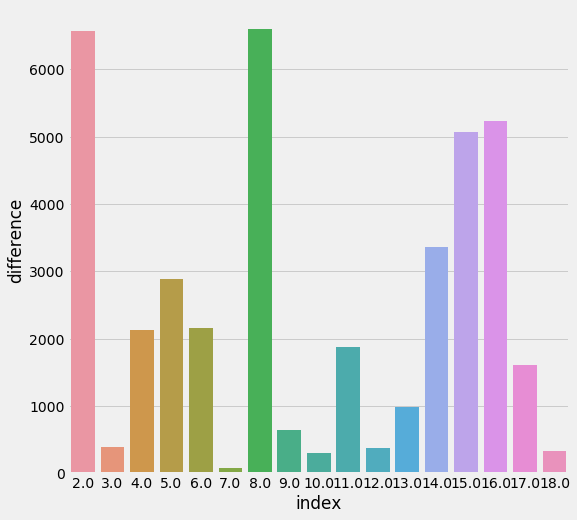

In [1301]:
fig=plt.figure(figsize=(8,8))
sns.barplot(data=merge_c,x='index',y='difference')

1.Males shopped for more in product category 2


In [1302]:
purchase_by_male=single_male.groupby('Product_Category_2')['Purchase'].mean().sort_values(ascending=False)

In [1303]:
purchase_by_male

Product_Category_2
10.0    15700.475728
2.0     13501.916924
6.0     11743.568663
3.0     10926.505092
8.0     10516.417101
15.0    10504.256339
16.0    10451.140509
18.0    10070.307895
4.0     10061.202797
13.0     9601.390278
5.0      9569.361019
17.0     9564.047643
11.0     8959.529663
9.0      7255.381738
14.0     7138.526923
7.0      7137.031250
12.0     7010.317910
Name: Purchase, dtype: float64

In [1304]:
purchase_by_female=single_female.groupby('Product_Category_2')['Purchase'].mean().sort_values(ascending=False)

In [1305]:
purchase_by_female

Product_Category_2
10.0    15104.036697
2.0     13563.007869
3.0     10970.518868
6.0     10568.432292
4.0     10551.780392
15.0     9978.667587
16.0     9750.961841
8.0      9373.857286
17.0     8680.453125
13.0     8608.358862
11.0     8178.293103
5.0      8141.820809
9.0      7343.574627
12.0     7139.771626
7.0      7128.650000
18.0     7017.980000
14.0     6925.055086
Name: Purchase, dtype: float64

In [1306]:
purchase_by_female=purchase_by_female.reset_index()
purchase_by_male=purchase_by_male.reset_index()

In [1307]:
purchase_by_male

,Product_Category_2,Purchase
0,10.0,15700.475728
1,2.0,13501.916924
2,6.0,11743.568663
3,3.0,10926.505092
4,8.0,10516.417101
5,15.0,10504.256339
6,16.0,10451.140509
7,18.0,10070.307895
8,4.0,10061.202797
9,13.0,9601.390278


In [1308]:
purchase_by_female

,Product_Category_2,Purchase
0,10.0,15104.036697
1,2.0,13563.007869
2,3.0,10970.518868
3,6.0,10568.432292
4,4.0,10551.780392
5,15.0,9978.667587
6,16.0,9750.961841
7,8.0,9373.857286
8,17.0,8680.453125
9,13.0,8608.358862


In [1309]:
merge_p=pd.merge(purchase_by_female,purchase_by_male,on='Product_Category_2',suffixes=('_female','_male'))

In [1310]:
merge_p['Difference']=merge_p['Purchase_male']-merge_p['Purchase_female']

In [1311]:
ml_merge_p=merge_p[merge_p['Difference']>0]
fl_merge_p=np.abs(merge_p[merge_p['Difference']<0])

Text(0.5, 1.0, 'Products males spent more on in category 2')

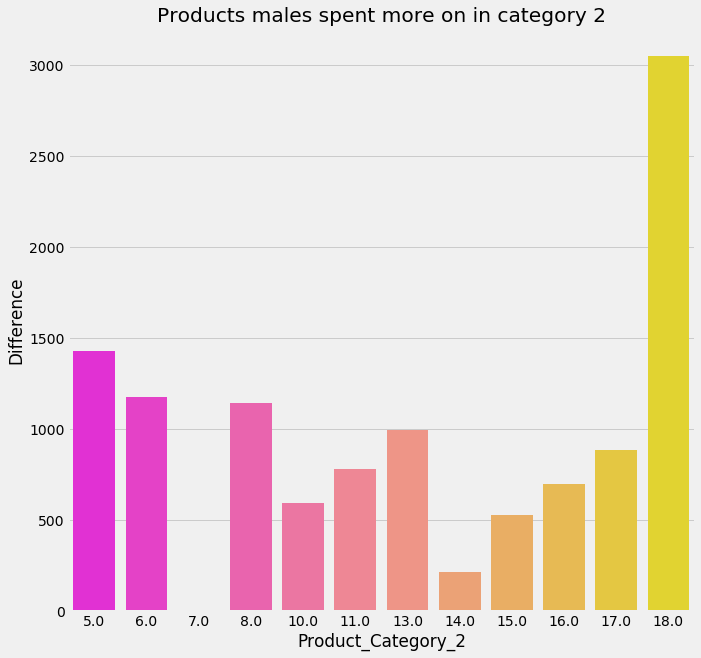

In [1312]:
fig=plt.figure(figsize=(10,10))
sns.barplot(data=ml_merge_p,x='Product_Category_2',y='Difference',palette='spring')
plt.title('Products males spent more on in category 2')

Text(0.5, 1.0, 'Products females spent more on in category 2')

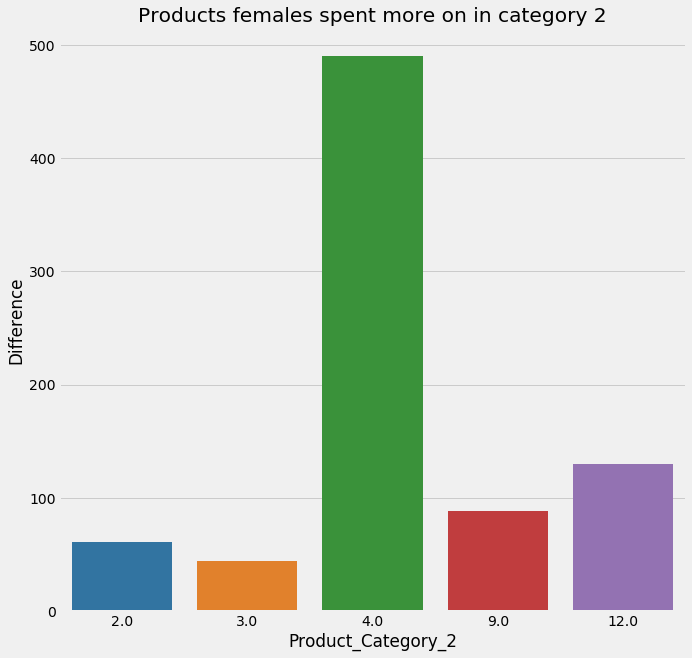

In [1313]:
fig=plt.figure(figsize=(10,10))
sns.barplot(data=fl_merge_p,x='Product_Category_2',y='Difference',palette='tab10')
plt.title('Products females spent more on in category 2')

1.Females spent more on product 2 despite being only 1887 while males were 10055

2.They spent more on product 3 and 4 9,12 and 2

3.Males spent more in the rest products

In [1314]:
mar_f=bf[(bf['Age']=='26-35')&(bf['Marital_Status']==1)&(bf['Gender']=='F')]
mar_m=bf[(bf['Age']=='26-35')&(bf['Marital_Status']==1)&(bf['Gender']=='M')]

In [1315]:
vc_mar_f=mar_f['Product_Category_2'].value_counts()
vc_mar_m=mar_m['Product_Category_2'].value_counts()

In [1316]:
pbmf=mar_f.groupby(['Product_Category_2'])['Purchase'].mean().sort_values(ascending=False)

In [1317]:
pbmm=mar_m.groupby(['Product_Category_2'])['Purchase'].mean().sort_values(ascending=False)

In [1318]:
pbmf=pbmf.reset_index()
pbmm=pbmm.reset_index()

In [1319]:
pbmf

,Product_Category_2,Purchase
0,10.0,15245.123596
1,2.0,13832.337553
2,3.0,11207.172414
3,6.0,11181.134831
4,4.0,10762.691995
5,16.0,10242.299049
6,15.0,10056.022005
7,8.0,9430.751992
8,17.0,9359.218341
9,13.0,9099.411765


In [1320]:
merge_s=pd.merge(pbmm,pbmf,on='Product_Category_2',suffixes=('_married male','married_female'))

In [1321]:
merge_s['difference']=merge_s['Purchase_married male']-merge_s['Purchasemarried_female']

In [1322]:
merge_s

,Product_Category_2,Purchase_married male,Purchasemarried_female,difference
0,10.0,15463.300781,15245.123596,218.177186
1,2.0,13386.238338,13832.337553,-446.099215
2,6.0,11662.513401,11181.134831,481.378569
3,3.0,11369.953333,11207.172414,162.780920
4,8.0,10451.736010,9430.751992,1020.984017
5,16.0,10425.516106,10242.299049,183.217057
6,15.0,10421.652854,10056.022005,365.630849
7,4.0,10005.185536,10762.691995,-757.506459
8,18.0,9826.418605,8708.268293,1118.150312
9,5.0,9426.920138,8980.607504,446.312634


In [1323]:
merge_mm=merge_s[merge_s['difference']>0]
merge_fm=np.abs(merge_s[merge_s['difference']<0])

Text(0.5, 1.0, 'Products married men spent more than married females')

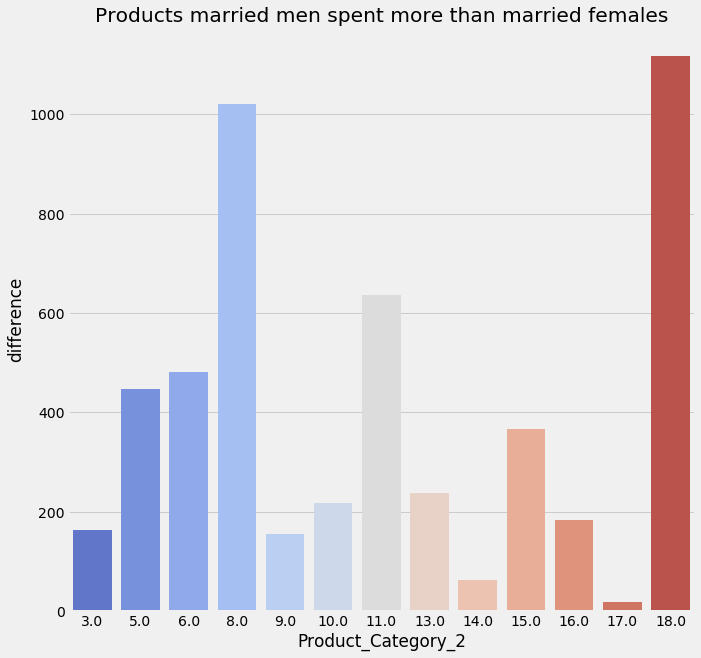

In [1324]:
fig=plt.figure(figsize=(10,10))
sns.barplot(data=merge_mm,y='difference',x='Product_Category_2',palette='coolwarm')
plt.title('Products married men spent more than married females')

Text(0.5, 1.0, 'Products married men spent more than married females')

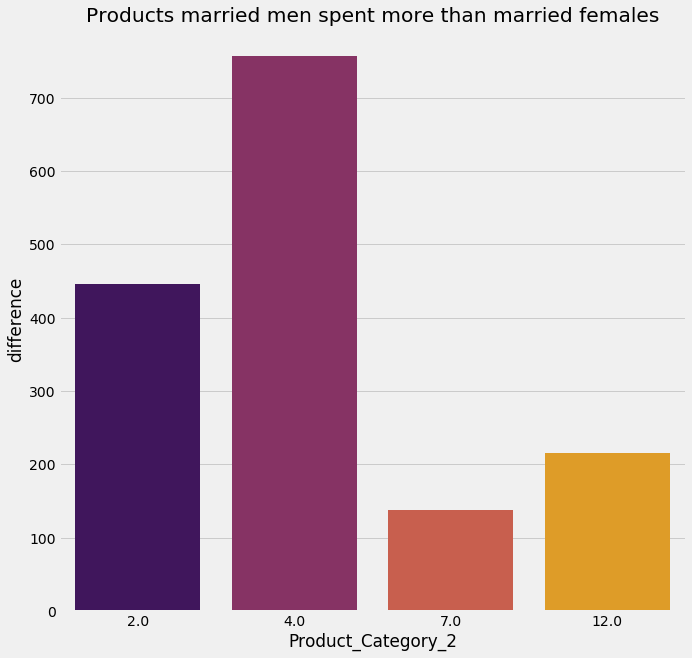

In [1325]:
fig=plt.figure(figsize=(10,10))
sns.barplot(data=merge_fm,y='difference',x='Product_Category_2',palette='inferno')
plt.title('Products married men spent more than married females')

1.Married females spent more on product 2,4,7 and 12 than Married men

2.Married males spent more on the rest


## 2.2.14 Gender ,Age,Status and product 3 vs Purchase 

In [1326]:
single_female=bf[(bf['Age']=='26-35')&(bf['Marital_Status']==0)&(bf['Gender']=='F')]
single_male=bf[(bf['Age']=='26-35')&(bf['Marital_Status']==0)&(bf['Gender']=='M')]

In [1327]:
value_count_females=single_female['Product_Category_3'].value_counts()
value_count_males=single_male['Product_Category_3'].value_counts()

In [1328]:
value_count_females

16.0    1198
14.0     972
15.0     737
5.0      715
17.0     575
8.0      483
12.0     433
9.0      415
13.0     205
6.0      136
18.0     130
10.0      75
4.0       64
11.0      62
3.0       13
Name: Product_Category_3, dtype: int64

In [1329]:
value_count_males

16.0    5256
15.0    4732
14.0    2620
5.0     2427
17.0    2386
8.0     1898
9.0     1679
12.0    1241
6.0      913
13.0     871
18.0     683
4.0      305
11.0     293
10.0     259
3.0      120
Name: Product_Category_3, dtype: int64

In [1330]:
value_count_male=value_count_males.reset_index()
value_count_female=value_count_females.reset_index()

In [1331]:
merge_c=pd.merge(value_count_male,value_count_female,on='index',how='inner',suffixes=('_male','_female'))

In [1332]:
merge_c['difference']=merge_c['Product_Category_3_male']-merge_c['Product_Category_3_female']

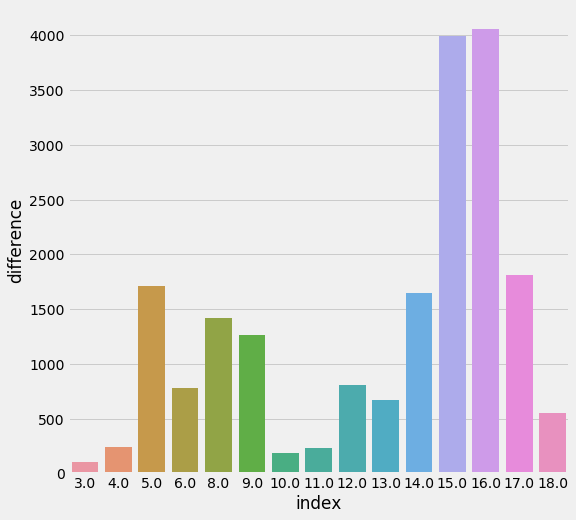

In [1333]:
fig=plt.figure(figsize=(8,8))
sns.barplot(data=merge_c,x='index',y='difference')

In [1334]:
purchase_by_male=single_male.groupby('Product_Category_3')['Purchase'].mean().sort_values(ascending=False)
purchase_by_female=single_female.groupby('Product_Category_3')['Purchase'].mean().sort_values(ascending=False)

In [1335]:
purchase_by_female=purchase_by_female.reset_index()
purchase_by_male=purchase_by_male.reset_index()

In [1336]:
merge_p=pd.merge(purchase_by_female,purchase_by_male,on='Product_Category_3',suffixes=('_female','_male'))

In [1337]:
merge_p['Difference']=merge_p['Purchase_male']-merge_p['Purchase_female']

In [1338]:
merge_pm=merge_p[merge_p['Difference']>0]
merge_fm=np.abs(merge_p[merge_p['Difference']<0])

Text(0.5, 1.0, 'Products single males purchased more than single females')

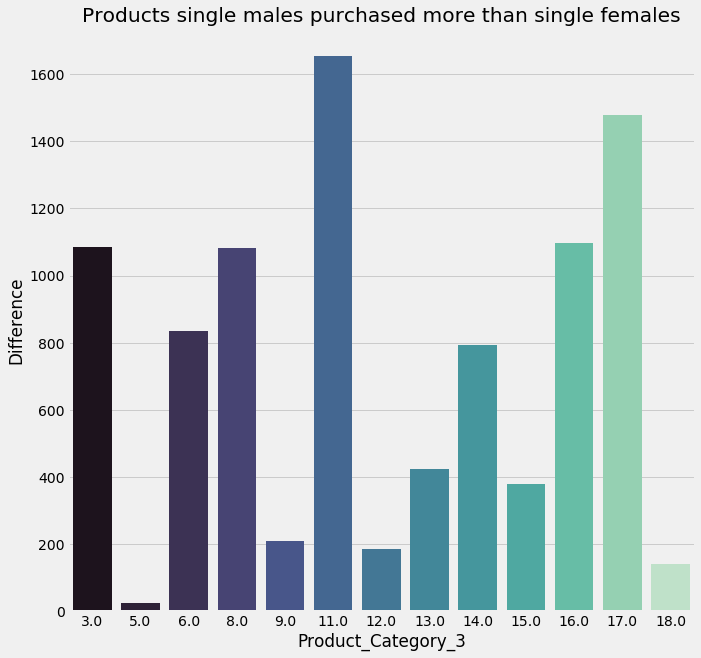

In [1339]:
fig=plt.figure(figsize=(10,10))
sns.barplot(data=merge_pm,x='Product_Category_3',y='Difference',palette='mako')
plt.title('Products single males purchased more than single females')

Text(0.5, 1.0, 'Products single females purchased more than single males')

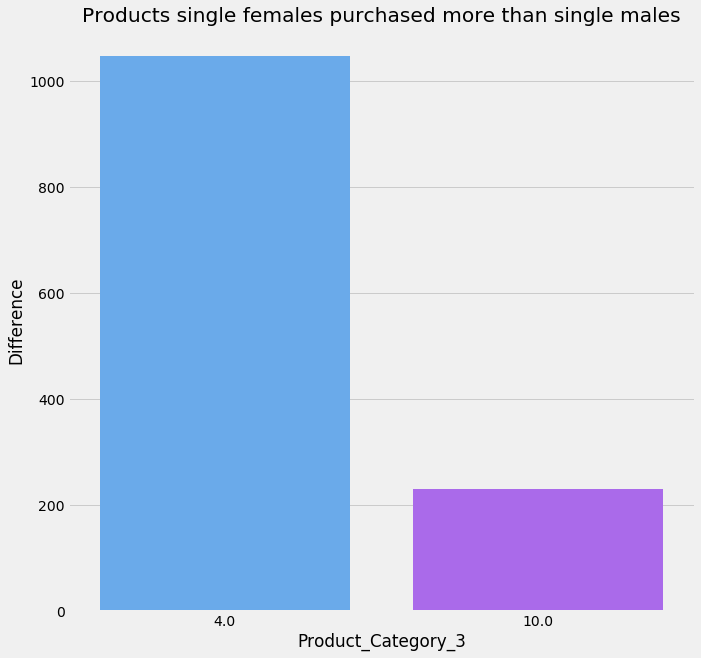

In [1355]:
fig=plt.figure(figsize=(10,10))
sns.barplot(data=merge_fm,x='Product_Category_3',y='Difference',palette='cool')
plt.title('Products single females purchased more than single males')

In [1341]:
mar_f=bf[(bf['Age']=='26-35')&(bf['Marital_Status']==1)&(bf['Gender']=='F')]
mar_m=bf[(bf['Age']=='26-35')&(bf['Marital_Status']==1)&(bf['Gender']=='M')]

In [1342]:
vc_mar_f=mar_f['Product_Category_3'].value_counts()
vc_mar_m=mar_m['Product_Category_3'].value_counts()

In [1343]:
pbmf=mar_f.groupby(['Product_Category_3'])['Purchase'].mean().sort_values(ascending=False)

In [1344]:
pbmm=mar_m.groupby(['Product_Category_3'])['Purchase'].mean().sort_values(ascending=False)

In [1345]:
pbmf=pbmf.reset_index()
pbmm=pbmm.reset_index()

In [1346]:
merge_s=pd.merge(pbmm,pbmf,on='Product_Category_3',suffixes=('_married male','married_female'))

In [1347]:
merge_s['difference']=merge_s['Purchase_married male']-merge_s['Purchasemarried_female']

In [1348]:
merge_smm=merge_s[merge_s['difference']>0]
merge_smf=np.abs(merge_s[merge_s['difference']<0])

Text(0.5, 1.0, 'Items married males spent on more than females')

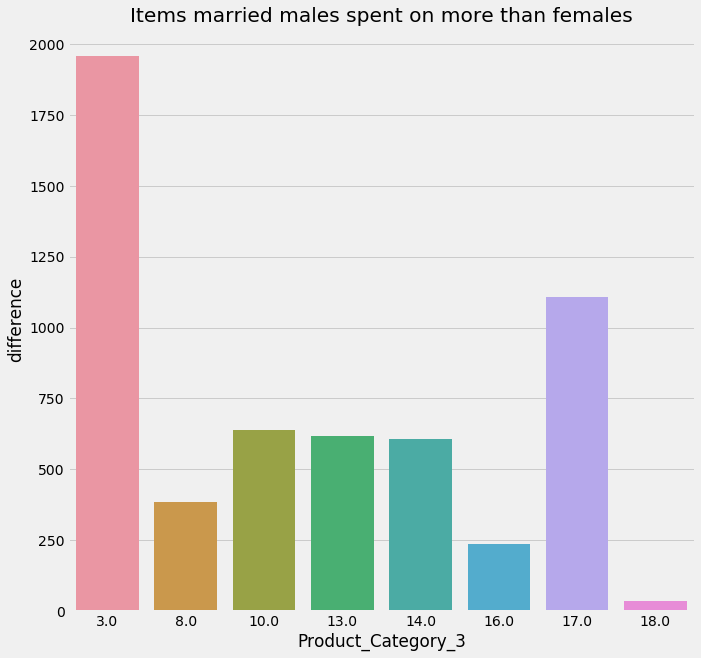

In [1351]:
fig=plt.figure(figsize=(10,10))
sns.barplot(data=merge_smm,y='difference',x='Product_Category_3')
plt.title('Items married males spent on more than females')


Text(0.5, 1.0, 'Items married females spent on more than males')

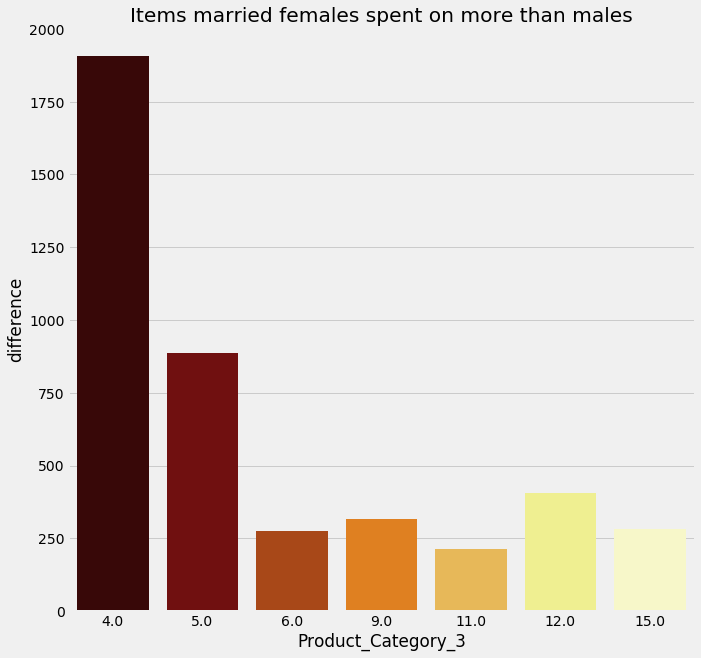

In [1354]:
fig=plt.figure(figsize=(10,10))
sns.barplot(data=merge_smf,y='difference',x='Product_Category_3',palette='afmhot')
plt.title('Items married females spent on more than males')

1.Single F spent more on category 4,10

2.Married F spent more on category 4,5,6,9,12,15 and 11

## 2.2.15 Correlation matrix

In [511]:
'''Find correlation between numeric features and create a heatmap'''
corr=bf.corr()

In [210]:
mask = np.zeros_like(corr)

In [211]:
mask[np.triu_indices_from(mask)] = True

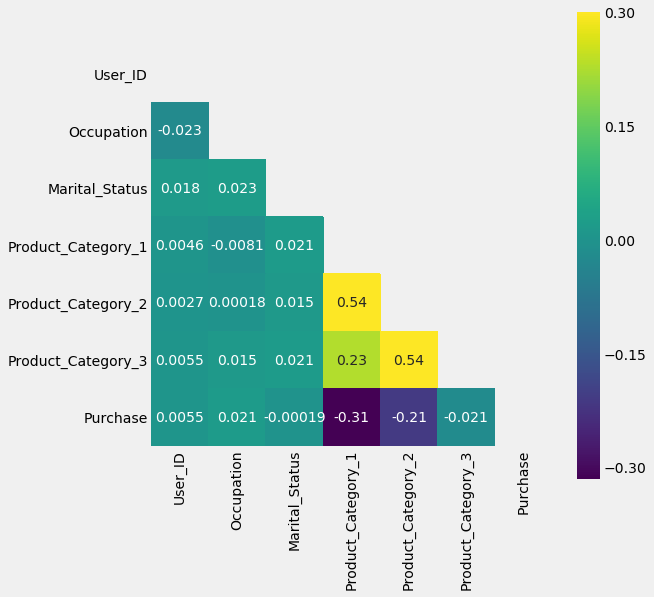

In [495]:
fig=plt.figure(figsize=(8,8))
sns.heatmap(corr, mask=mask, vmax=.3, square=True,cmap='viridis',annot=True)



# 3.Data pre-processing

## 3.1 Imput missing values 

In [509]:
#Find percentage of missing values in colmns
bf.isnull().sum()/bf.shape[0]*100

User_ID                        0.000000
Product_ID                     0.000000
Gender                         0.000000
Age                            0.000000
Occupation                     0.000000
City_Category                  0.000000
Stay_In_Current_City_Years     0.000000
Marital_Status                 0.000000
Product_Category_1             0.000000
Product_Category_2            31.009322
Product_Category_3            69.415269
Purchase                       0.000000
dtype: float64

In [510]:
#Create an imputer strategy bases on most frequent values
imputer = Imputer(strategy='most_frequent')

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/utils/deprecation.py:58: DeprecationWarning:

Class Imputer is deprecated; Imputer was deprecated in version 0.20 and will be removed in 0.22. Import impute.SimpleImputer from sklearn instead.



In [1356]:
#Apply imputer strategy to train and test data
bf['Product_Category_2']=imputer.fit_transform(bf['Product_Category_2'].values.reshape(-1,1))
bf['Product_Category_3']=imputer.fit_transform(bf['Product_Category_3'].values.reshape(-1,1))
test['Product_Category_3']=imputer.fit_transform(test['Product_Category_3'].values.reshape(-1,1))
test['Product_Category_2']=imputer.fit_transform(test['Product_Category_2'].values.reshape(-1,1))

In [1357]:
#Confirm there are no nulls
bf.isnull().sum()

User_ID                       0
Product_ID                    0
Gender                        0
Age                           0
Occupation                    0
City_Category                 0
Stay_In_Current_City_Years    0
Marital_Status                0
Product_Category_1            0
Product_Category_2            0
Product_Category_3            0
Purchase                      0
dtype: int64

# 4.Feature Engineering

## 4.1 Gender 

In [217]:
#Create dictionary for gender
g_dict={'M':1,'F':0}

In [505]:
#Map to train and test data
bf['Gender']=bf['Gender'].map(g_dict)
test['Gender']=test['Gender'].map(g_dict)

In [219]:
bf['Gender'].value_counts()

1    324555
0    105506
Name: Gender, dtype: int64

## 4.1 Age

In [220]:
#Create age dictionary
age_dict = {'0-17':0, '18-25':1, '26-35':2, '36-45':3, '46-50':4, '51-55':5, '55+':6}

In [506]:
#Map to age
bf['Age']=bf['Age'].map(age_dict)
test['Age']=test['Age'].map(age_dict)

In [222]:
bf['Age'].value_counts()

2    171754
3     86084
1     77910
4     35682
5     30081
6     16719
0     11831
Name: Age, dtype: int64

## 4.2 City category

In [507]:
#create city category dictionary then map to train and test data
city_dict = {'A':0, 'B':1, 'C':2}
bf['City_Category']=bf['City_Category'].map(city_dict)
test['City_Category']=test['City_Category'].map(city_dict)


## 4.3 Stay in city years 

In [508]:
#Create a label encoder
le=LabelEncoder()

In [225]:
bf['Stay_In_Current_City_Years']=le.fit_transform(bf['Stay_In_Current_City_Years'])
test['Stay_In_Current_City_Years']=le.fit_transform(test['Stay_In_Current_City_Years'])

In [226]:
#final dataset
bf.head(15)

,User_ID,Product_ID,Gender,Age,Occupation,City_Category,Stay_In_Current_City_Years,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase
22467,1003521,P00178342,1,2,0,1,3,0,8,8.0,16.0,7837
42611,1000553,P00285842,1,2,2,1,1,0,5,8.0,16.0,8762
461991,1005113,P00271342,1,2,0,0,3,1,8,14.0,16.0,7778
144091,1004224,P00058142,0,4,1,2,1,1,3,4.0,12.0,13701
97400,1003095,P00125642,0,2,3,1,1,1,5,14.0,16.0,7158
350913,1000019,P00032142,1,0,10,0,3,0,5,11.0,16.0,6947
25940,1003992,P00221042,1,2,4,1,1,0,1,17.0,16.0,15889
387459,1005627,P00044442,1,2,0,0,4,1,1,16.0,16.0,15369
315523,1000655,P00030642,0,2,2,1,2,0,8,8.0,16.0,5891
468421,1000148,P0096842,1,5,17,1,3,1,3,4.0,12.0,11068


In [227]:
def getCountVar(compute_df, count_df, var_name):
    grouped_df = count_df.groupby(var_name)
    count_dict = {}
    for name, group in grouped_df:
        count_dict[name] = group.shape[0]
    count_list = []
    for index, row in compute_df.iterrows():
        name = row[var_name]
        count_list.append(count_dict.get(name, 0))
    return count_list

In [228]:
bf["User_ID_count"]=getCountVar(bf,bf,'User_ID')
bf["Product_ID_count"]=getCountVar(bf,bf,'Product_ID')
bf["Product_Category_1_count"]=getCountVar(bf,bf,'Product_Category_1')
bf["Product_Category_2_count"]=getCountVar(bf,bf,'Product_Category_2')


bf["Gender_count"]=getCountVar(bf,bf,'Gender')

test["User_ID_count"]=getCountVar(test,test,'User_ID')
test["Product_ID_count"]=getCountVar(test,test,'Product_ID')
test["Product_Category_1_count"]=getCountVar(test,test,'Product_Category_1')
test["Product_Category_2_count"]=getCountVar(test,test,'Product_Category_2')


test["Gender_count"]=getCountVar(test,test,'Gender')


In [229]:
def getProductVar(compute_df,count_df,var_name):
    grouped_df=count_df.groupby(var_name)
    min_dict={}
    max_dict={}
    mean_dict={}
    for name,group in grouped_df:
        min_dict[name]=np.min(np.array(group['Purchase']))
        max_dict[name]=np.max(np.array(group['Purchase']))
        mean_dict[name]=np.mean(np.array(group['Purchase']))
        
    max_list=[]
    min_list=[]
    mean_list=[]
        
    for index,row in compute_df.iterrows():
        name=row[var_name]
        min_list.append(min_dict.get(name,0))
        max_list.append(max_dict.get(name,0))
        mean_list.append(mean_dict.get(name,0))
        
    return max_list,min_list,mean_list    
        

In [230]:
max_l,min_l,mean_list=getProductVar(bf,bf,'User_ID')
max_l1,min_l1,mean_list1=getProductVar(test,test,'User_ID')

In [231]:
bf['User_id_min_price']=min_l
bf['User_id_max_price']=max_l
bf['User_id_mean_price']=mean_list
test['User_id_min_price']=min_l1
test['User_id_max_price']=max_l1
test['User_id_mean_price']=mean_list1

In [232]:
max_l,min_l,mean_list=getProductVar(bf,bf,'Product_ID')
max_l1,min_l1,mean_list1=getProductVar(test,test,'Product_ID')
bf['Product_id_min_price']=min_l
bf['Product_id_max_price']=max_l
bf['Product_mean_price']=mean_list
test['Product_id_min_price']=min_l1
test['Product_id_max_price']=max_l1
test['Product_mean_price']=mean_list1

## 4.4 Occupation 

In [233]:
bf['Stay_In_Current_City_Years'] = le.fit_transform(bf['Stay_In_Current_City_Years'])
test['Stay_In_Current_City_Years'] = le.fit_transform(test['Stay_In_Current_City_Years'])

In [234]:
#Create dummies for Stay in current city
bf = pd.get_dummies(bf, columns=['Stay_In_Current_City_Years'])
test = pd.get_dummies(test, columns=['Stay_In_Current_City_Years'])

In [1358]:
#Remove ID columns
bf.drop(['Product_ID','User_ID'],axis=1,inplace=True)
test.drop(['Product_ID','User_ID'],axis=1,inplace=True)

In [236]:
bf.head()

,Gender,Age,Occupation,City_Category,Marital_Status,Product_Category_1,Product_Category_2,Product_Category_3,Purchase,User_ID_count,...,User_id_max_price,User_id_mean_price,Product_id_min_price,Product_id_max_price,Product_mean_price,Stay_In_Current_City_Years_0,Stay_In_Current_City_Years_1,Stay_In_Current_City_Years_2,Stay_In_Current_City_Years_3,Stay_In_Current_City_Years_4
22467,1,2,0,1,0,8,8.0,16.0,7837,182,...,23620,8655.456044,2014,10082,7720.193772,0,0,0,1,0
42611,1,2,2,1,0,5,8.0,16.0,8762,28,...,15934,7389.250000,1723,8906,6598.916870,0,1,0,0,0
461991,1,2,0,0,1,8,14.0,16.0,7778,208,...,23868,6373.706731,3955,10054,7876.581395,0,0,0,1,0
144091,0,4,1,2,1,3,4.0,12.0,13701,129,...,23711,8576.604651,2661,13717,10449.031949,0,1,0,0,0
97400,0,2,3,1,1,5,14.0,16.0,7158,74,...,19577,8627.837838,1754,8881,5593.837500,0,1,0,0,0


In [237]:
bf.shape

(430061, 25)

In [238]:
bf.drop(['Stay_In_Current_City_Years_4','Stay_In_Current_City_Years_0','Stay_In_Current_City_Years_3','Stay_In_Current_City_Years_1','Age','Marital_Status'],axis=1,inplace=True)

In [239]:
bf.head()

,Gender,Occupation,City_Category,Product_Category_1,Product_Category_2,Product_Category_3,Purchase,User_ID_count,Product_ID_count,Product_Category_1_count,Product_Category_2_count,Gender_count,User_id_min_price,User_id_max_price,User_id_mean_price,Product_id_min_price,Product_id_max_price,Product_mean_price,Stay_In_Current_City_Years_2
22467,1,0,1,8,8.0,16.0,7837,182,289,89614,183800,324555,775,23620,8655.456044,2014,10082,7720.193772,0
42611,1,2,1,5,8.0,16.0,8762,28,409,118757,183800,324555,1800,15934,7389.250000,1723,8906,6598.916870,0
461991,1,0,0,8,14.0,16.0,7778,208,43,89614,43403,324555,572,23868,6373.706731,3955,10054,7876.581395,0
144091,0,1,2,3,4.0,12.0,13701,129,313,15852,20073,105506,567,23711,8576.604651,2661,13717,10449.031949,0
97400,0,3,1,5,14.0,16.0,7158,74,80,118757,43403,105506,2052,19577,8627.837838,1754,8881,5593.837500,0


In [240]:
yTrain=bf['Purchase']
bf.drop(['Purchase'],axis=1,inplace=True)
yTest=test['Purchase']
test.drop(['Purchase','Stay_In_Current_City_Years_4','Stay_In_Current_City_Years_0','Stay_In_Current_City_Years_3','Stay_In_Current_City_Years_1','Age','Marital_Status'],axis=1,inplace=True)

In [241]:
xTrain=bf
xTest=test

In [242]:
xTrain.head()

,Gender,Occupation,City_Category,Product_Category_1,Product_Category_2,Product_Category_3,User_ID_count,Product_ID_count,Product_Category_1_count,Product_Category_2_count,Gender_count,User_id_min_price,User_id_max_price,User_id_mean_price,Product_id_min_price,Product_id_max_price,Product_mean_price,Stay_In_Current_City_Years_2
22467,1,0,1,8,8.0,16.0,182,289,89614,183800,324555,775,23620,8655.456044,2014,10082,7720.193772,0
42611,1,2,1,5,8.0,16.0,28,409,118757,183800,324555,1800,15934,7389.250000,1723,8906,6598.916870,0
461991,1,0,0,8,14.0,16.0,208,43,89614,43403,324555,572,23868,6373.706731,3955,10054,7876.581395,0
144091,0,1,2,3,4.0,12.0,129,313,15852,20073,105506,567,23711,8576.604651,2661,13717,10449.031949,0
97400,0,3,1,5,14.0,16.0,74,80,118757,43403,105506,2052,19577,8627.837838,1754,8881,5593.837500,0


# 5.Modelling

In [243]:
def modelfit(alg, xtrain,ytrain):
    #Fit the algorithm on the data
    alg.fit(xtrain,ytrain)
        
    #Predict training set:
    dtrain_predictions = alg.predict(xtrain)#Perform cross-validation:
    cv_score = cross_val_score(alg, xtrain,(ytrain) , cv=20, scoring='neg_mean_squared_error')
    cv_score = np.sqrt(np.abs(cv_score))
    
    #Print model report:
    print("\nModel Report")
    print("RMSE : %.4g" % np.sqrt(metrics.mean_squared_error((ytrain).values, dtrain_predictions)))
    print("CV Score : Mean - %.4g | Std - %.4g | Min - %.4g | Max - %.4g" % (np.mean(cv_score),np.std(cv_score),np.min(cv_score),np.max(cv_score)))
    
    #Predict on testing data:
    #dtest[target] = alg.predict(dtest[predictors])

## 5.1 Linear regression 

In [244]:
lr=LinearRegression()
modelfit(lr,xTrain,yTrain)


Model Report
RMSE : 2564
CV Score : Mean - 2564 | Std - 15.02 | Min - 2536 | Max - 2594


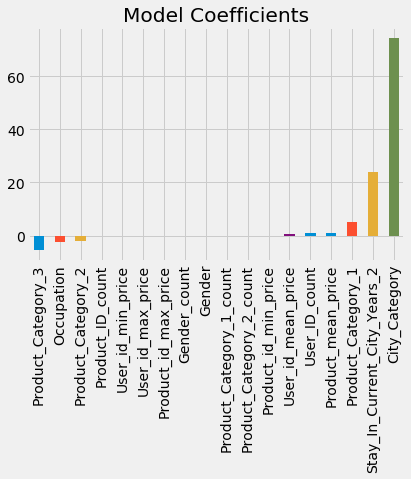

In [245]:
coef1 = pd.Series(lr.coef_, xTrain.columns).sort_values()
coef1.plot(kind='bar', title='Model Coefficients')

In [246]:
preds = lr.predict(xTest)
rmse = np.sqrt(metrics.mean_squared_error(yTest, preds))
print("RMSE: %f" % (rmse))

RMSE: 2512.365983


## 5.2 DecisionTree

In [247]:
dr=DecisionTreeRegressor(max_depth=50,min_samples_leaf=150)

In [248]:
modelfit(dr,xTrain,yTrain)


Model Report
RMSE : 2465
CV Score : Mean - 2531 | Std - 12.76 | Min - 2506 | Max - 2555


In [249]:
#rmse on test data
preds = dr.predict(xTest)
rmse = np.sqrt(metrics.mean_squared_error(yTest, preds))
print("RMSE: %f" % (rmse))

RMSE: 2508.350175


In [250]:
xTrain.columns

Index(['Gender', 'Occupation', 'City_Category', 'Product_Category_1',
       'Product_Category_2', 'Product_Category_3', 'User_ID_count',
       'Product_ID_count', 'Product_Category_1_count',
       'Product_Category_2_count', 'Gender_count', 'User_id_min_price',
       'User_id_max_price', 'User_id_mean_price', 'Product_id_min_price',
       'Product_id_max_price', 'Product_mean_price',
       'Stay_In_Current_City_Years_2'],
      dtype='object')

In [251]:
#Show feature importances
dr.feature_importances_

array([3.21589528e-04, 6.50852265e-04, 3.57503999e-04, 1.05311969e-04,
       1.56595284e-04, 6.07201997e-05, 3.82029685e-03, 6.71981967e-04,
       6.63767128e-04, 2.28217761e-04, 5.56179875e-04, 3.25059382e-03,
       6.45812397e-03, 3.48033093e-02, 7.57329369e-04, 1.35414034e-03,
       9.45732528e-01, 5.09586486e-05])

In [252]:
t=sorted(zip(dr.feature_importances_,xTrain.columns),reverse=True)

In [253]:
t

[(0.9457325276822192, 'Product_mean_price'),
 (0.03480330934632174, 'User_id_mean_price'),
 (0.006458123969608588, 'User_id_max_price'),
 (0.003820296845891235, 'User_ID_count'),
 (0.003250593820457277, 'User_id_min_price'),
 (0.0013541403432339447, 'Product_id_max_price'),
 (0.0007573293685080476, 'Product_id_min_price'),
 (0.000671981966649129, 'Product_ID_count'),
 (0.0006637671275561243, 'Product_Category_1_count'),
 (0.0006508522653281693, 'Occupation'),
 (0.0005561798754052691, 'Gender_count'),
 (0.000357503999039648, 'City_Category'),
 (0.0003215895275656711, 'Gender'),
 (0.00022821776075503342, 'Product_Category_2_count'),
 (0.00015659528401678588, 'Product_Category_2'),
 (0.00010531196909675778, 'Product_Category_1'),
 (6.072019974707214e-05, 'Product_Category_3'),
 (5.095864860049559e-05, 'Stay_In_Current_City_Years_2')]

## 5.3 Randomforest 

In [254]:
rf=RandomForestRegressor(max_depth=8,min_samples_leaf=150)
modelfit(rf,xTrain,yTrain)

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.




Model Report
RMSE : 2509
CV Score : Mean - 2521 | Std - 13.98 | Min - 2495 | Max - 2546


In [255]:
#RMSE on test data
preds = rf.predict(xTest)
rmse = np.sqrt(metrics.mean_squared_error(yTest, preds))
print("RMSE: %f" % (rmse))

RMSE: 2455.767055


In [256]:
rf.feature_importances_

array([1.54742223e-04, 3.58963716e-05, 3.93944892e-05, 1.36575016e-04,
       1.91469502e-05, 1.47363370e-05, 1.72443022e-03, 1.24539584e-04,
       1.94145247e-04, 4.08360326e-05, 1.24913191e-04, 1.12130274e-03,
       4.31457657e-03, 3.27383872e-02, 2.21634885e-04, 8.22334422e-04,
       9.58172409e-01, 0.00000000e+00])

In [257]:
sorted(zip(rf.feature_importances_,xTrain.columns),reverse=True)

[(0.9581724085579552, 'Product_mean_price'),
 (0.03273838715296358, 'User_id_mean_price'),
 (0.004314576572869276, 'User_id_max_price'),
 (0.0017244302249405908, 'User_ID_count'),
 (0.0011213027415383743, 'User_id_min_price'),
 (0.0008223344221847375, 'Product_id_max_price'),
 (0.0002216348854439815, 'Product_id_min_price'),
 (0.00019414524749993174, 'Product_Category_1_count'),
 (0.00015474222321259357, 'Gender'),
 (0.00013657501581768668, 'Product_Category_1'),
 (0.00012491319085335408, 'Gender_count'),
 (0.000124539584104704, 'Product_ID_count'),
 (4.083603264030227e-05, 'Product_Category_2_count'),
 (3.9394489241776495e-05, 'City_Category'),
 (3.589637157133844e-05, 'Occupation'),
 (1.9146950185687767e-05, 'Product_Category_2'),
 (1.4736336977008735e-05, 'Product_Category_3'),
 (0.0, 'Stay_In_Current_City_Years_2')]

## 5.4 Ridge

In [258]:
rg=Ridge()

In [259]:
modelfit(rg,xTrain,yTrain)


Model Report
RMSE : 2564
CV Score : Mean - 2564 | Std - 15.02 | Min - 2536 | Max - 2594


1.Random fore performed the best on test data with RMSE of 2455

2.Product category 1 is the most important feature

# 6.HyperParameter tuning

In [260]:
from sklearn.model_selection import GridSearchCV

In [261]:
param_grid=[{
    'max_depth':[100,150,200,250],'min_samples_leaf':[100,150,200,250,300]
}]

In [262]:
rf=RandomForestRegressor()
grid_search=GridSearchCV(rf,param_grid,cv=5,scoring='neg_mean_squared_error')
grid_search.fit(xTrain,yTrain)

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/fo

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/fo

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/forest.py:246: FutureWarning:

The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.

/home/lytica/anaconda3/lib/python3.6/site-packages/sklearn/ensemble/fo

GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_decrease=0.0, min_impurity_split=None,
           min_samples_leaf=1, min_samples_split=2,
           min_weight_fraction_leaf=0.0, n_estimators='warn', n_jobs=None,
           oob_score=False, random_state=None, verbose=0, warm_start=False),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid=[{'max_depth': [100, 150, 200, 250], 'min_samples_leaf': [100, 150, 200, 250, 300]}],
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring='neg_mean_squared_error', verbose=0)

In [502]:
#best parameters
grid_search.best_params_

{'max_depth': 200, 'min_samples_leaf': 100}

In [503]:
#best dcore
grid_search.best_score_

-6244976.627647747

In [504]:
best=grid_search.best_estimator_
#rmse on test data
preds = best.predict(xTest)
rmse = np.sqrt(metrics.mean_squared_error(yTest, preds))
print("RMSE: %f" % (rmse))

RMSE: 2453.310978


In [266]:
A = yTest.values.reshape(-1, 1)
B = preds.reshape(-1, 1)


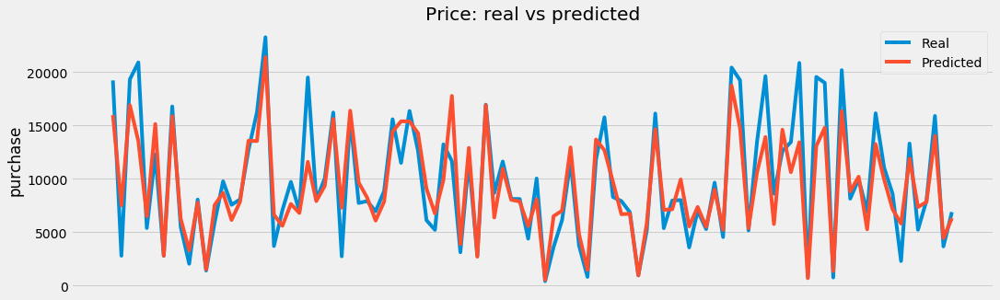

In [267]:
plt.rcParams['figure.figsize'] = 16,5
plt.figure()
plt.plot(A[100:200], label="Real")
plt.plot(B[100:200], label="Predicted")
plt.legend()
plt.title("Price: real vs predicted")
plt.ylabel("purchase")
plt.xticks(())
plt.show()



Hyperparameter tuning brings down the RMSE score on test data from 2455 to 2453

In [268]:
#save model
joblib.dump(best,'BF.pkl')

['BF.pkl']